# **CNN, XGBoost & Grad-CAM ·**

In [1]:
%pip install \
absl-py \
astunparse \
blinker \
cachetools \
certifi \
charset-normalizer \
click \
colorama \
contourpy \
cycler \
Flask \
flatbuffers==1.12 \
fonttools \
gast==0.5.3 \
google-auth \
google-auth-oauthlib==0.4.6 \
google-pasta==0.2.0 \
grpcio==1.44.0 \
gunicorn \
h5py==3.6.0 \
idna \
itsdangerous \
jax \
Jinja2 \
joblib \
keras==2.8.0 \
kiwisolver \
libclang \
Markdown \
MarkupSafe \
matplotlib \
numpy==1.22.4 \
oauthlib \
opencv-python-headless \
opt-einsum==3.3.0 \
packaging \
Pillow \
protobuf==3.19.6 \
pyasn1 \
pyasn1-modules \
pyparsing \
python-dateutil \
requests \
requests-oauthlib \
rsa \
scikit-learn \
scipy \
six \
tensorboard==2.8.0 \
tensorboard-data-server==0.6.1 \
tensorflow-gpu==2.8.0 \
tensorflow-estimator==2.8.0 \
termcolor \
threadpoolctl \
typing_extensions \
urllib3 \
Werkzeug \
wrapt \
xgboost \
pandas==2.0.3 \
seaborn==0.12.2


Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 25.2 -> 25.3
[notice] To update, run: python.exe -m pip install --upgrade pip


In [2]:
import tensorflow as tf

print("="*50)
print("🔷 TensorFlow Version:", tf.__version__)
print("="*50)

gpus = tf.config.list_physical_devices("GPU")
print("🔷 GPU Devices:", gpus)

if not gpus:
    print("\n❌ No GPU detected by TensorFlow!\n")
else:
    for i, gpu in enumerate(gpus):
        print(f"\n===== GPU {i} =====")
        details = tf.config.experimental.get_device_details(gpu)
        for k, v in details.items():
            print(f"{k}: {v}")

print("="*50)

from tensorflow.python.platform import build_info as tf_build_info

cuda_version = tf_build_info.build_info.get("cuda_version", "Unknown")
cudnn_version = tf_build_info.build_info.get("cudnn_version", "Unknown")

print("🔧 CUDA version:", cuda_version)
print("🔧 cuDNN version:", cudnn_version)

print("="*50)

print("🔍 Log device placement: ENABLED")


🔷 TensorFlow Version: 2.8.0
🔷 GPU Devices: [PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

===== GPU 0 =====
device_name: NVIDIA GeForce RTX 4090
compute_capability: (8, 9)
🔧 CUDA version: 64_112
🔧 cuDNN version: 64_8
🔍 Log device placement: ENABLED


In [3]:
''' Cell 0: Load Local Dataset '''
# ============================
# 🔹 Install splitfolders
# ============================
%pip install split-folders

import splitfolders

# ============================
# 🔹 Define paths
# ============================
input_folder = r"F:\Sabbir_Research\LAST MODEL RUN\X RAY\dataset"
output_folder = r"F:\Sabbir_Research\LAST MODEL RUN\X RAY\split_dataset"

# ============================
# 🔹 Split dataset
# ============================
splitfolders.ratio(
    input_folder,
    output=output_folder,
    seed=1337,
    ratio=(.7, .15, .15),  # train, val, test
    group_prefix=None,  # keep classes separate
    move=False  # use copy instead of move (set True to move files)
)

print("✅ Dataset successfully split into Training (70%), Validation (15%), Testing (15%)")


Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 25.2 -> 25.3
[notice] To update, run: python.exe -m pip install --upgrade pip


✅ Dataset successfully split into Training (70%), Validation (15%), Testing (15%)


In [4]:
''' Cell 1: Load Local Dataset '''

# Import necessary library
import os

# Define name of dataset (this should match your folder name)
dataset_name = 'split_dataset'   

# Define paths for training, validation, and testing sets
train_dir = f'./{dataset_name}/train'
val_dir = f'./{dataset_name}/val'
test_dir = f'./{dataset_name}/test'

# Verify dataset exists
if os.path.isdir(dataset_name) and os.path.isdir(train_dir) and os.path.isdir(val_dir) and os.path.isdir(test_dir):
    print('\n\033[1m\033[32m' + f'Found local dataset: {dataset_name}' + '\033[0m\n')
else:
    print('\n\033[1m\033[31m' + f'Dataset {dataset_name} not found. Please check the folder path.' + '\033[0m\n')
    raise Exception(f'Dataset {dataset_name} not found. Please check the folder path.')


Found local dataset: split_dataset



In [5]:
''' Cell 2: Display Software Specifications '''

# Import necessary libraries
import platform
import tensorflow as tf
from tensorflow import keras
import xgboost as xgb
import cv2
import numpy as np
import sklearn
import matplotlib
import pandas as pd
import seaborn as sns

# Define software libraries and versions
software_specs = [
    ['Python', platform.python_version()],
    ['TensorFlow', tf.__version__],
    ['Keras', keras.__version__],
    ['XGBoost', xgb.__version__],
    ['OpenCV', cv2.__version__],
    ['NumPy', np.__version__],
    ['Scikit-Learn', sklearn.__version__],
    ['Matplotlib', matplotlib.__version__],
    ['Pandas', pd.__version__],
    ['Seaborn', sns.__version__]
]

# Convert software specifications into DataFrame
df_software = pd.DataFrame(software_specs)

# Display software specifications DataFrame
print('\n\033[1m\033[36m' + 'Software Specifications' + '\033[0m\n')
display(df_software.style.hide(axis='index').hide(axis='columns').set_properties(**{'text-align': 'left'}))
print()


Software Specifications



Python,3.10.0
TensorFlow,2.8.0
Keras,2.8.0
XGBoost,3.1.1
OpenCV,4.11.0
NumPy,1.22.4
Scikit-Learn,1.7.2
Matplotlib,3.8.4
Pandas,2.0.3
Seaborn,0.12.2


In [6]:
''' Cell 3: Display Hardware Specifications (Cross-Platform) '''

import pandas as pd
import subprocess
import platform
import psutil
import shutil

# ---------- Helpers ----------
def run_command(cmd):
    try:
        return subprocess.run(cmd, stdout=subprocess.PIPE, shell=True).stdout.decode('utf-8').strip()
    except Exception:
        return ""

def mhz_to_ghz(mhz_string):
    if not mhz_string or mhz_string.strip() == "":
        return "N/A"
    try:
        mhz_value = float(mhz_string.replace('MHz', '').strip())
        return f'{mhz_value / 1000:.3g} GHz'
    except ValueError:
        return "N/A"

def k_to_mb(k_string):
    if not k_string or k_string.strip() == "":
        return "N/A"
    try:
        k_value = float(k_string.replace('K', '').replace('MiB', '').strip())
        return f'{k_value:.3g} MB'
    except ValueError:
        return "N/A"

def kb_to_gb(kb_string):
    if not kb_string or kb_string.strip() == "":
        return "N/A"
    try:
        kb_value = float(kb_string.replace('kB', '').strip())
        return f'{kb_value / 1024**2:.3g} GB'
    except ValueError:
        return "N/A"

# ---------- CPU ----------
cpu_specs = []
if shutil.which("lscpu"):  # Linux / Colab
    cpu_specs = [
        ['CPU Model', run_command('lscpu | grep "Model name"').split(':')[-1].strip()],
        ['Sockets', run_command('lscpu | grep "Socket(s):"').split(':')[-1].strip()],
        ['Cores per Socket', run_command('lscpu | grep "Core(s) per socket"').split(':')[-1].strip()],
        ['Threads per Core', run_command('lscpu | grep "Thread(s) per core"').split(':')[-1].strip()],
        ['Clock Speed', mhz_to_ghz(run_command('lscpu | grep MHz').split(':')[-1].strip())],
        ['L3 Cache', k_to_mb(run_command('lscpu | grep "L3 cache"').split(':')[-1].strip())]
    ]
else:  # Windows fallback
    cpu_specs = [
        ['CPU Model', platform.processor()],
        ['Physical Cores', psutil.cpu_count(logical=False)],
        ['Logical Cores', psutil.cpu_count(logical=True)],
        ['Clock Speed', f"{psutil.cpu_freq().current/1000:.2f} GHz" if psutil.cpu_freq() else "N/A"]
    ]

# ---------- GPU ----------
gpu_specs = []
if shutil.which("nvidia-smi"):
    gpu_info = run_command("nvidia-smi -L")
    gpu_model = gpu_info.split(':')[1].split(' (')[0] if gpu_info else 'No GPU detected'
    gpu_specs = [['GPU Model', gpu_model]]
else:
    gpu_specs = [['GPU Model', 'No NVIDIA GPU detected']]

# ---------- RAM ----------
if shutil.which("free"):  # Linux
    ram_total = kb_to_gb(run_command("free | grep Mem | awk '{print $2}'"))
else:  # Windows fallback
    ram_total = f"{round(psutil.virtual_memory().total / (1024**3), 2)} GB"
ram_specs = [['Total System RAM', ram_total]]

# ---------- Storage ----------
if shutil.which("df"):  # Linux
    storage_total = run_command("df -BG / | awk 'NR==2 {print $2}'").replace('G', ' GB')
else:  # Windows fallback
    storage_total = f"{round(psutil.disk_usage('/').total / (1024**3), 2)} GB"
storage_specs = [['Total Disk Space', storage_total]]

# ---------- Combine ----------
hardware_specs = cpu_specs + gpu_specs + ram_specs + storage_specs
df_hardware = pd.DataFrame(hardware_specs, columns=["Spec", "Value"])

# ---------- Display ----------
print('\n\033[1m\033[36m' + 'Hardware Specifications' + '\033[0m\n')
display(df_hardware.style.hide(axis='index').set_properties(**{'text-align': 'left'}))
print()



Hardware Specifications



Spec,Value
CPU Model,"Intel64 Family 6 Model 183 Stepping 1, GenuineIntel"
Physical Cores,24
Logical Cores,32
Clock Speed,3.00 GHz
GPU Model,NVIDIA GeForce RTX 4090
Total System RAM,127.76 GB
Total Disk Space,1242.01 GB


## Data Preprocessing

In [7]:
''' Cell 4: Define Image Preprocessing Function '''

# Define function to preprocess input images
def preprocess_image(image):
    try:
        image = cv2.resize(image, (256, 256))  # Resize image to standard size of 256x256 pixels
        image = image / 255.0  # Normalize pixel values to range [0, 1] for optimal deep learning performance
        return image
    except Exception as e:
        raise Exception('Preprocessing error')

## Data Augmentation

In [8]:
''' Cell 5: Set Up Image Data Generators with Data Augmentation '''

# Import necessary library
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Set up data augmentation techniques for training data to increase diversity of training samples and improve model robustness
data_generator = ImageDataGenerator(
    preprocessing_function=preprocess_image,  # Apply preprocessing function to every image
    rotation_range=10,  # Rotate images up to 10 degrees randomly
    width_shift_range=0.05,  # Shift images horizontally by up to 5% of width randomly
    height_shift_range=0.05,  # Shift images vertically by up to 5% of height randomly
    horizontal_flip=True,  # Randomly flip images horizontally
    brightness_range=[0.8, 1.2],  # Randomly change brightness
    zoom_range=[0.8, 1.2]  # Randomly zoom in on images
)

# Create ImageDataGenerator instances for training, validation, and testing sets
train_datagen = data_generator

# Do not apply augmentation to validation and testing sets, only preprocessing
val_datagen = ImageDataGenerator(preprocessing_function=preprocess_image)
test_datagen = ImageDataGenerator(preprocessing_function=preprocess_image)

## Dataset Preparation

In [9]:
''' Cell 6: Generate Image Batches and Display Dataset Distribution '''

# Import necessary library
import sys

# Set batch size for data generators
batch_size = 32

# Temporarily redirect standard output to null to suppress verbose output
original_stdout = sys.stdout
sys.stdout = open(os.devnull, 'w')

# Generate batches of tensor image data with real-time data augmentation for training set
train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(256, 256),
    batch_size=batch_size,
    class_mode='categorical'
)

# Generate batches of tensor image data with real-time data augmentation for validation set
val_generator = val_datagen.flow_from_directory(
    val_dir,
    target_size=(256, 256),
    batch_size=batch_size,
    class_mode='categorical'
)

# Generate batches of tensor image data with real-time data augmentation for testing set
test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=(256, 256),
    batch_size=batch_size,
    class_mode='categorical',
    shuffle=False
)

# Restore standard output to original state
sys.stdout = original_stdout

# Store class indices and class names
classes = train_generator.class_indices
class_names = list(classes.keys())

# Calculate class distribution for each set
train_distribution = np.bincount(train_generator.labels)
val_distribution = np.bincount(val_generator.labels)
test_distribution = np.bincount(test_generator.labels)

# Prepare data for DataFrame representation of class distribution
class_data = [['Class', 'Index', 'Training', 'Validation', 'Testing']]
class_data += list(zip(
    class_names,
    list(classes.values()),
    list(train_distribution),
    list(val_distribution),
    list(test_distribution)
))

# Create DataFrame to represent class distribution
df_class = pd.DataFrame(class_data)

# Display class distribution DataFrame
print('\n\033[1m\033[36m' + 'Dataset Distribution Per Class' + '\033[0m\n')
display(df_class.style.hide(axis='index').hide(axis='columns').set_properties(**{'text-align': 'left'}))

# Calculate sum of images in each set
subtotals = [np.sum(train_distribution), np.sum(val_distribution), np.sum(test_distribution)]
total = np.sum(subtotals)

# Prepare data for DataFrame representation of set totals
set_data = [['Set', 'Count']]
set_data += list(zip(['Training', 'Validation', 'Testing', 'Total'], subtotals + [total]))

# Create DataFrame to represent set totals
df_set = pd.DataFrame(set_data)

# Display set totals DataFrame
print('\n\033[1m\033[36m' + 'Total Images Per Set' + '\033[0m\n')
display(df_set.style.hide(axis='index').hide(axis='columns').set_properties(**{'text-align': 'left'}))
print()


Dataset Distribution Per Class



Class,Index,Training,Validation,Testing
Bacterial Pneumonia,0,843,180,182
COVID,1,2531,542,543
Lung_Opacity,2,4208,901,903
Normal,3,7134,1528,1530
Tuberculosis,4,489,105,106
Viral Pneumonia,5,941,201,203



Total Images Per Set



Set,Count
Training,16146
Validation,3457
Testing,3467
Total,23070


## CNN Model Implementation

In [10]:
''' Cell 7: Define Function to Create Custom CNN Models '''

# Import necessary libraries
from keras.layers import Dense, GlobalAveragePooling2D
from keras.models import Model

# Define function to create CNN model with pre-trained base CNN model
def create_cnn_model(base_cnn_model):

    # Freeze layers of base CNN model
    for layer in base_cnn_model.layers:
        layer.trainable = False

    # Add custom layers to base CNN model
    x = base_cnn_model.output
    x = GlobalAveragePooling2D()(x)
    x = Dense(1024, activation='relu')(x)
    x = Dense(len(classes), activation='softmax')(x)

    # Define final CNN model
    cnn_model = Model(inputs=base_cnn_model.input, outputs=x)

    return cnn_model

In [11]:
''' Cell 8: Load Pre-trained Base CNN Models '''

# Import necessary libraries
from tensorflow.keras.applications import VGG16, ResNet50, InceptionV3

# Temporarily redirect standard output to null to suppress verbose output
original_stdout = sys.stdout
sys.stdout = open(os.devnull, 'w')

# Load pre-trained base CNN models (VGG16, ResNet50, InceptionV3) with pre-trained weights from ImageNet without top fully-connected layers
vgg16 = VGG16(weights='imagenet', include_top=False)
resnet50 = ResNet50(weights='imagenet', include_top=False)
inceptionv3 = InceptionV3(weights='imagenet', include_top=False)

# Restore standard output to original state
sys.stdout = original_stdout

# Define dictionary of CNN models for easy access
cnn_models = {
    'VGG16': vgg16,
    'ResNet50': resnet50,
    'InceptionV3': inceptionv3
}

In [13]:
# Note: Install latest version of Scikit-Optimize (skopt) Python library, if not already installed

! pip install -q -U scikit-optimize


[notice] A new release of pip is available: 25.2 -> 25.3
[notice] To update, run: python.exe -m pip install --upgrade pip


In [14]:
''' Cell 10: Define XGBoost Hyperparameter Tuning Function with Feature Selection '''

# Import necessary libraries
from skopt import BayesSearchCV
from skopt.space import Real, Integer
from sklearn.feature_selection import SelectFromModel

# Define function to tune hyperparameters of XGBoost model using Bayesian optimization and select important features
def tune_hyperparameters_and_select_features(train_features, train_labels):

    # Define search space for hyperparameters
    search_space = {
        'learning_rate': Real(0.001, 0.5, 'uniform'),  # Control learning speed of model
        'max_depth': Integer(3, 15),  # Determine maximum depth of tree
        'n_estimators': Integer(50, 500),  # Specify number of trees in ensemble
        'min_child_weight': Integer(1, 10),  # Control minimum sum of weights needed in child
        'gamma': Real(0, 1, 'uniform'),  # Specify minimum loss reduction required to make split
        'subsample': Real(0.1, 1.0, 'uniform'),  # Specify fraction of observations to be randomly sampled for each tree
        'colsample_bytree': Real(0.1, 1.0, 'uniform'),  # Specify fraction of columns to be randomly sampled for each tree
        'alpha': Real(0.0, 1.0),  # Control L1 regularization term on weights
        'lambda': Real(0.0, 1.0)  # Control L2 regularization term on weights
    }

    # Initialize XGBoost classifier with multi-class softmax objective, and preset random state for reproducibility
    xgb_model = xgb.XGBClassifier(
        objective='multi:softmax',
        random_state=42,
        n_jobs=-1,
        eval_metric='mlogloss'
    )

    # Perform Bayesian optimization using cross-validation and F1 score as scoring metric
    bayes_search = BayesSearchCV(
        xgb_model,
        search_space,
        cv=5,
        scoring='f1_macro',
        n_jobs=-1,
        n_iter=100
    )
    bayes_search.fit(train_features, train_labels)

    # Get best hyperparameters from Bayesian optimization
    best_params = bayes_search.best_params_

    # Initialize new XGBoost model with best hyperparameters
    new_xgb_model = xgb.XGBClassifier(
        objective='multi:softmax',
        random_state=42,
        n_jobs=-1,
        eval_metric='mlogloss',
        **best_params
    )

    # Fit XGBoost model with best hyperparameters to training data
    new_xgb_model.fit(train_features, train_labels)

    # Create selector object to select features with importance greater than specified threshold
    selector = SelectFromModel(new_xgb_model, threshold=0.1, prefit=True)

    # Transform training features by selecting only important features
    selected_train_features = selector.transform(train_features)

    return best_params, selected_train_features, selector

In [15]:
''' Cell 11: Define Model Evaluation Function '''

# Import necessary libraries
from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score, roc_auc_score
from sklearn.preprocessing import label_binarize

# Define function to evaluate performance of given model
def evaluate_model(model, x, y, model_name, classes):

    # Predict labels for given data using provided model
    y_pred = model.predict(x)

    # Compute accuracy, F1 score, precision, recall for predictions
    accuracy = accuracy_score(y, y_pred)
    f1 = f1_score(y, y_pred, average='weighted')
    precision = precision_score(y, y_pred, average='weighted')
    recall = recall_score(y, y_pred, average='weighted')

    # Compute specificity for predictions
    cm = confusion_matrix(y, y_pred)
    FP = cm.sum(axis=0) - np.diag(cm)
    FN = cm.sum(axis=1) - np.diag(cm)
    TP = np.diag(cm)
    TN = cm.sum() - (FP + FN + TP)
    specificity = np.mean(TN / (TN + FP))

    # Compute AUC-ROC for predictions
    y_bin = label_binarize(y, classes=[*range(len(classes))])
    y_pred_bin = label_binarize(y_pred, classes=[*range(len(classes))])
    auc_roc = roc_auc_score(y_bin, y_pred_bin, average='macro', multi_class='ovr')

    # Prepare data for DataFrame representation of performance metrics
    performance_data = [
        ['Accuracy', f'{accuracy:.2%}'],
        ['Precision', f'{precision:.2%}'],
        ['Recall', f'{recall:.2%}'],
        ['F1 Score', f'{f1:.2%}'],
        ['Specificity', f'{specificity:.2%}'],
        ['AUC-ROC', f'{auc_roc:.2%}']
    ]

    # Create DataFrame to represent performance metrics
    df_performance = pd.DataFrame(performance_data)

    # Display performance metrics DataFrame
    print('\n\033[1m\033[36m' + f'Performance Metrics of {model_name}' + '\033[0m\n')
    display(df_performance.style.hide(axis='index').hide(axis='columns').set_properties(**{'text-align': 'left'}))

    return accuracy, precision, recall, f1, specificity, auc_roc

In [16]:
from sklearn.metrics import confusion_matrix
from sklearn.metrics import (
    accuracy_score,
    precision_score,
    recall_score,
    f1_score,
    confusion_matrix,
    roc_auc_score
)


Tuning Hyperparameters and Selecting Features for VGG16-XGBoost Hybrid Model...

Training VGG16-XGBoost Hybrid Model...

[0]	validation_0-mlogloss:1.66608	validation_1-mlogloss:1.66577
[1]	validation_0-mlogloss:1.65711	validation_1-mlogloss:1.65711
[2]	validation_0-mlogloss:1.64823	validation_1-mlogloss:1.64857
[3]	validation_0-mlogloss:1.63949	validation_1-mlogloss:1.64015
[4]	validation_0-mlogloss:1.63077	validation_1-mlogloss:1.63176
[5]	validation_0-mlogloss:1.62212	validation_1-mlogloss:1.62340
[6]	validation_0-mlogloss:1.61359	validation_1-mlogloss:1.61515
[7]	validation_0-mlogloss:1.60511	validation_1-mlogloss:1.60698
[8]	validation_0-mlogloss:1.59677	validation_1-mlogloss:1.59893
[9]	validation_0-mlogloss:1.58852	validation_1-mlogloss:1.59097
[10]	validation_0-mlogloss:1.58030	validation_1-mlogloss:1.58304
[11]	validation_0-mlogloss:1.57214	validation_1-mlogloss:1.57517
[12]	validation_0-mlogloss:1.56404	validation_1-mlogloss:1.56733
[13]	validation_0-mlogloss:1.55606	validati

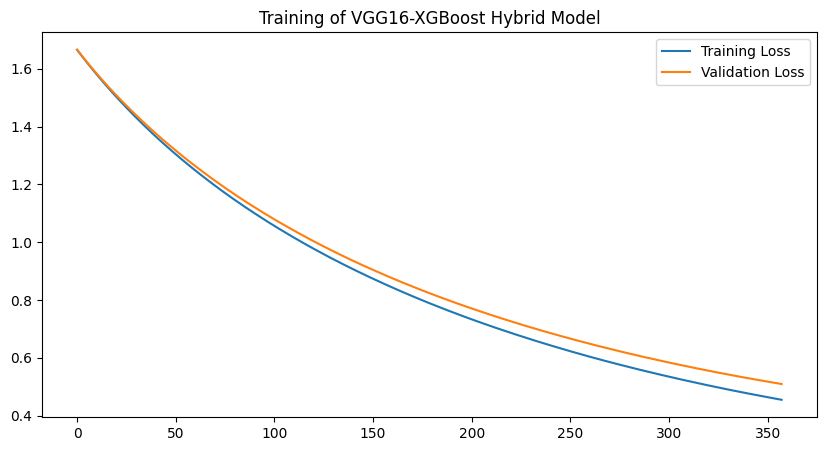


Performance Metrics of VGG16-XGBoost Hybrid Model



Accuracy,91.82%
Precision,92.24%
Recall,91.82%
F1 Score,91.72%
Specificity,98.03%
AUC-ROC,93.36%



Tuning Hyperparameters and Selecting Features for ResNet50-XGBoost Hybrid Model...

Training ResNet50-XGBoost Hybrid Model...

[0]	validation_0-mlogloss:1.54772	validation_1-mlogloss:1.54342
[1]	validation_0-mlogloss:1.44743	validation_1-mlogloss:1.44009
[2]	validation_0-mlogloss:1.36558	validation_1-mlogloss:1.35648
[3]	validation_0-mlogloss:1.29647	validation_1-mlogloss:1.28696
[4]	validation_0-mlogloss:1.23783	validation_1-mlogloss:1.22826
[5]	validation_0-mlogloss:1.18819	validation_1-mlogloss:1.17794
[6]	validation_0-mlogloss:1.14463	validation_1-mlogloss:1.13463
[7]	validation_0-mlogloss:1.10631	validation_1-mlogloss:1.09699
[8]	validation_0-mlogloss:1.07282	validation_1-mlogloss:1.06462
[9]	validation_0-mlogloss:1.04392	validation_1-mlogloss:1.03619
[10]	validation_0-mlogloss:1.01768	validation_1-mlogloss:1.01107
[11]	validation_0-mlogloss:0.99453	validation_1-mlogloss:0.98935
[12]	validation_0-mlogloss:0.97400	validation_1-mlogloss:0.96976
[13]	validation_0-mlogloss:0.95536	va

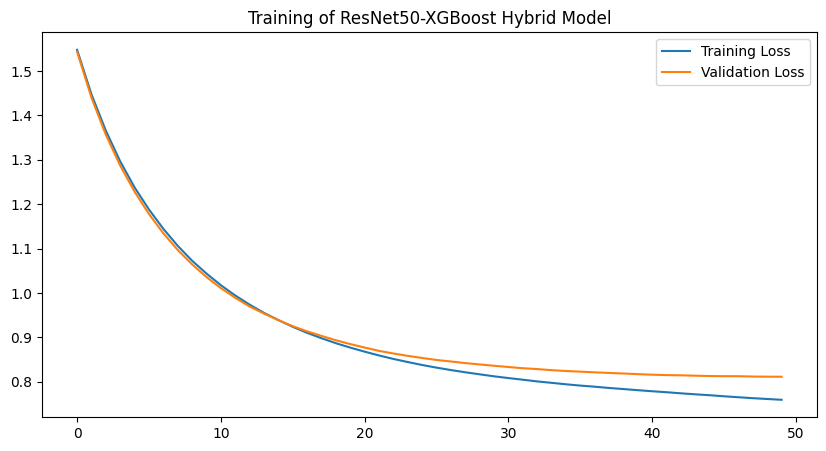


Performance Metrics of ResNet50-XGBoost Hybrid Model



Accuracy,67.07%
Precision,66.04%
Recall,67.07%
F1 Score,65.05%
Specificity,91.86%
AUC-ROC,72.59%



Tuning Hyperparameters and Selecting Features for InceptionV3-XGBoost Hybrid Model...

Training InceptionV3-XGBoost Hybrid Model...

[0]	validation_0-mlogloss:1.50409	validation_1-mlogloss:1.50658
[1]	validation_0-mlogloss:1.16638	validation_1-mlogloss:1.16361
[2]	validation_0-mlogloss:1.06455	validation_1-mlogloss:1.06345
[3]	validation_0-mlogloss:0.92080	validation_1-mlogloss:0.92178
[4]	validation_0-mlogloss:0.83879	validation_1-mlogloss:0.84363
[5]	validation_0-mlogloss:0.80380	validation_1-mlogloss:0.81168
[6]	validation_0-mlogloss:0.77447	validation_1-mlogloss:0.78417
[7]	validation_0-mlogloss:0.72919	validation_1-mlogloss:0.74057
[8]	validation_0-mlogloss:0.69762	validation_1-mlogloss:0.70953
[9]	validation_0-mlogloss:0.66845	validation_1-mlogloss:0.68050
[10]	validation_0-mlogloss:0.64134	validation_1-mlogloss:0.65495
[11]	validation_0-mlogloss:0.62138	validation_1-mlogloss:0.63867
[12]	validation_0-mlogloss:0.60497	validation_1-mlogloss:0.62412
[13]	validation_0-mlogloss:0.58

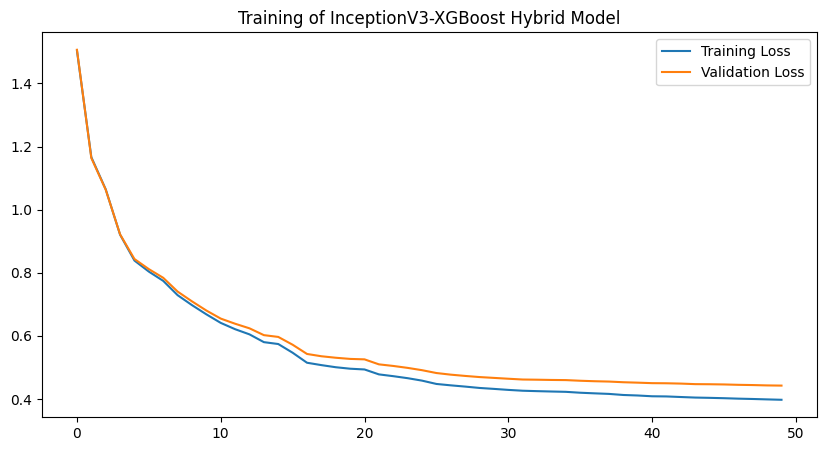


Performance Metrics of InceptionV3-XGBoost Hybrid Model



Accuracy,83.62%
Precision,84.23%
Recall,83.62%
F1 Score,83.08%
Specificity,95.95%
AUC-ROC,85.71%



The best performing model is VGG16-XGBoost, achieving F1 score of 91.72%



In [18]:
''' Cell 12: Extract Features with CNN, Classify Images with XGBoost and Evaluate Hybrid Models '''

# Define dictionaries to store features and labels for each model for both training and validation sets
train_features_dict = {}
val_features_dict = {}
train_labels_dict = {}
val_labels_dict = {}

# Initialize dictionaries with empty lists for each trained CNN model
for cnn_model_name in cnn_models.keys():
    train_features_dict[cnn_model_name] = []
    val_features_dict[cnn_model_name] = []
    train_labels_dict[cnn_model_name] = []
    val_labels_dict[cnn_model_name] = []

# Calculate steps per epoch and validation steps
train_steps = train_generator.samples // train_generator.batch_size
val_steps = val_generator.samples // val_generator.batch_size

# Extract features and labels using trained CNN models
for cnn_model_name, cnn_model in cnn_models.items():

    # Temporarily suppress verbose output
    original_stdout = sys.stdout
    sys.stdout = open(os.devnull, 'w')

    # Extract features for training set
    for _ in range(train_steps):
        train_images, train_labels = next(train_generator)
        batch_features = cnn_model.predict(train_images)
        train_features_dict[cnn_model_name].extend(batch_features)
        train_labels_dict[cnn_model_name].extend(np.argmax(train_labels, axis=1))

    # Extract features for validation set
    for _ in range(val_steps):
        val_images, val_labels = next(val_generator)
        batch_features = cnn_model.predict(val_images)
        val_features_dict[cnn_model_name].extend(batch_features)
        val_labels_dict[cnn_model_name].extend(np.argmax(val_labels, axis=1))

    # Restore stdout
    sys.stdout = original_stdout

    # Convert to numpy arrays
    train_features_dict[cnn_model_name] = np.array(train_features_dict[cnn_model_name])
    val_features_dict[cnn_model_name] = np.array(val_features_dict[cnn_model_name])
    train_labels_dict[cnn_model_name] = np.array(train_labels_dict[cnn_model_name])
    val_labels_dict[cnn_model_name] = np.array(val_labels_dict[cnn_model_name])

# Initialize variables to store best F1 score and model
best_f1 = 0
best_hybrid_model = None
best_cnn_model = None
best_cnn_model_name = ''

# Find best hybrid model
for cnn_model_name, cnn_model in cnn_models.items():

    print(f'\nTuning Hyperparameters and Selecting Features for {cnn_model_name}-XGBoost Hybrid Model...')
    xgb_params, selected_train_features, selector = tune_hyperparameters_and_select_features(
        train_features_dict[cnn_model_name],
        train_labels_dict[cnn_model_name]
    )

    # Apply same selector to validation features
    selected_val_features = selector.transform(val_features_dict[cnn_model_name])

    # Prepare evaluation sets using selected features (FIXED)
    eval_set = [
        (selected_train_features, train_labels_dict[cnn_model_name]),
        (selected_val_features, val_labels_dict[cnn_model_name])
    ]

    # Initialize XGBoost classifier
    xgb_model = xgb.XGBClassifier(
        objective='multi:softmax',
        random_state=42,
        n_jobs=-1,
        eval_metric='mlogloss',
        early_stopping_rounds=10,
        **xgb_params
    )

    print(f'\nTraining {cnn_model_name}-XGBoost Hybrid Model...\n')
    xgb_model.fit(
        selected_train_features,
        train_labels_dict[cnn_model_name],
        eval_set=eval_set,      # USES SELECTED FEATURES NOW
        verbose=True
    )

    # Plot training and validation losses
    plt.figure(figsize=(10, 5))
    plt.title(f'Training of {cnn_model_name}-XGBoost Hybrid Model')
    plt.plot(xgb_model.evals_result()['validation_0']['mlogloss'], label='Training Loss')
    plt.plot(xgb_model.evals_result()['validation_1']['mlogloss'], label='Validation Loss')
    plt.legend()
    plt.show()

    # Evaluate hybrid model
    accuracy, precision, recall, f1, specificity, auc_roc = evaluate_model(
        xgb_model,
        selected_val_features,
        val_labels_dict[cnn_model_name],
        f'{cnn_model_name}-XGBoost Hybrid Model',
        classes
    )

    # Track best model
    if f1 > best_f1:
        best_f1 = f1
        best_hybrid_model = xgb_model
        best_cnn_model = cnn_model
        best_cnn_model_name = cnn_model_name

print(f'\nThe best performing model is {best_cnn_model_name}-XGBoost, achieving F1 score of {best_f1:.2%}\n')


## CNN-XGBoost Hybrid Model Evaluation and Testing

In [20]:
''' Cell 13: Define Function for Plotting Confusion Matrix '''

# Import necessary library
from sklearn.metrics import confusion_matrix

# Define function to plot confusion matrix
def plot_confusion_matrix(y_true, y_pred, model_name, classes):

    # Compute confusion matrix from true and predicted labels
    cm = confusion_matrix(y_true, y_pred)

    # Calculate percentage matrix
    cm_sum = np.sum(cm, axis=1, keepdims=True)
    cm_perc = cm / cm_sum.astype(float) * 100
    annot = np.empty_like(cm).astype(str)

    # Add number of images and percentage to annotations
    nrows, ncols = cm.shape
    for i in range(nrows):
        for j in range(ncols):
            c = cm[i, j]
            p = cm_perc[i, j]
            if i == j:
                s = cm_sum[i][0]
                annot[i, j] = f'{p:.2f}%\n({c} of {s})'
            elif c == 0:
                annot[i, j] = ''
            else:
                annot[i, j] = f'{p:.2f}%\n({c})'

    # Create new figure for confusion matrix
    fig, ax = plt.subplots(figsize=(8, 8))

    # Display confusion matrix as heatmap
    sns.heatmap(cm, annot=annot, fmt='', square=True, cbar=False, cmap=plt.cm.Blues, ax=ax)

    # Set labels for x and y axes
    ax.set_xlabel('Predicted Class')
    ax.set_ylabel('Actual Class')

    # Set title for plot
    ax.set_title(f'Confusion Matrix of {model_name}')

    # Extract class names and sort by index
    class_names = [k for k, v in sorted(classes.items(), key=lambda item: item[1])]

    # Set class names as tick labels for x and y axes
    ax.set_xticklabels(class_names)
    ax.set_yticklabels(class_names)
    ax.tick_params(axis='x', colors='#999999')
    ax.tick_params(axis='y', colors='#999999')

    # Display plot
    print()
    plt.show()

In [21]:
''' Cell 14: Retrieve Features and Labels for Best CNN Model '''

# Retrieve features for training and validation sets corresponding to best performing CNN model
train_features = train_features_dict[best_cnn_model_name]
val_features = val_features_dict[best_cnn_model_name]

# Retrieve corresponding labels for best performing CNN model
train_labels_xgb = train_labels_dict[best_cnn_model_name]
val_labels_xgb = val_labels_dict[best_cnn_model_name]

In [22]:
''' Cell 15: Tune Hyperparameters and Select Features for Final Hybrid Model '''

# Perform hyperparameter tuning and feature selection on hybrid model using features extracted by best performing CNN model
print('\n\033[1m\033[36m' + f'Tuning Hyperparameters and Selecting Features for Final {best_cnn_model_name}-XGBoost Model...' + '\033[0m\n')
xgb_params, selected_train_features, selector = tune_hyperparameters_and_select_features(
    train_features,
    train_labels_xgb
)

# Select important features from validation set using same selector
selected_val_features = selector.transform(val_features)


Tuning Hyperparameters and Selecting Features for Final VGG16-XGBoost Model...




Training Final VGG16-XGBoost Model...



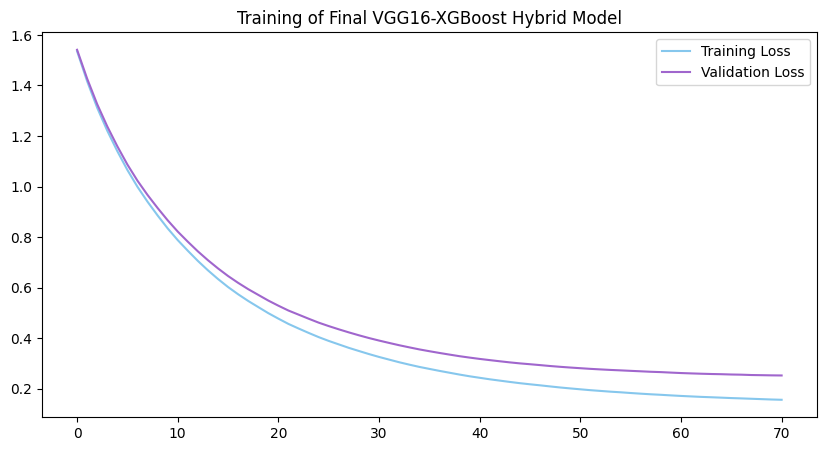

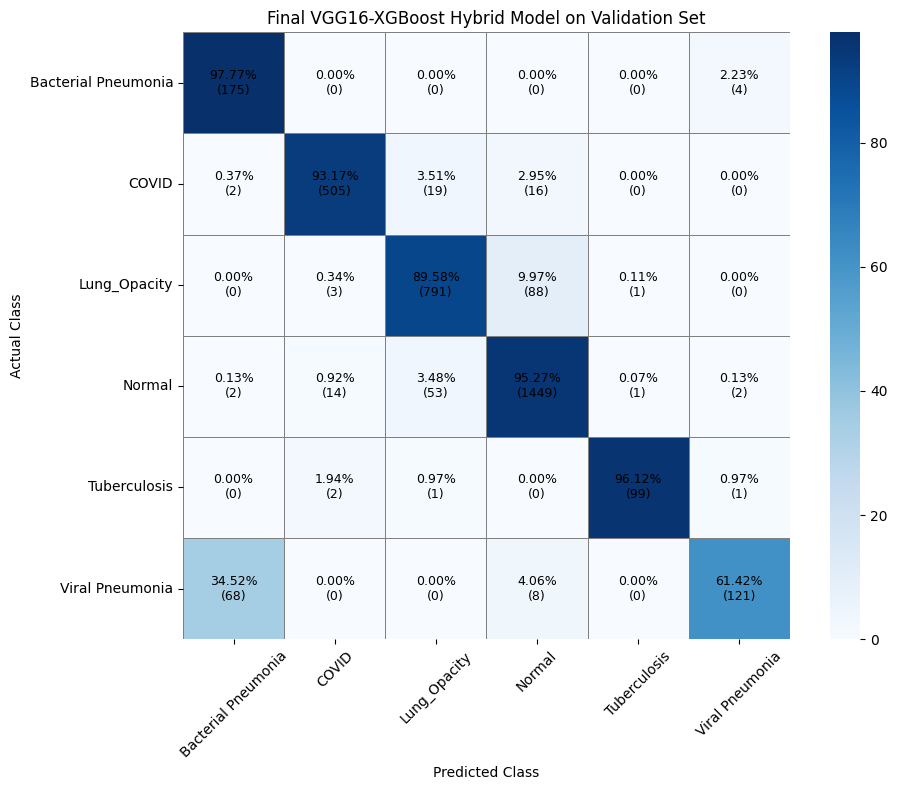


Performance Metrics of Final VGG16-XGBoost Hybrid Model on Validation Set



Accuracy,91.68%
Precision,92.16%
Recall,91.68%
F1 Score,91.59%
Specificity,98.02%
AUC-ROC,93.45%


In [29]:
''' Cell 16: Train and Evaluate Final Hybrid Model '''

# Initialize XGBoost classifier with multi-class softmax objective, and preset random state for reproducibility
final_hybrid_model = xgb.XGBClassifier(
    objective='multi:softmax',
    random_state=42,
    n_jobs=-1,
    eval_metric='mlogloss',
    early_stopping_rounds=10,
    **xgb_params
)

# Create evaluation set comprising of selected training and validation features
eval_set = [(selected_train_features, train_labels_xgb), (selected_val_features, val_labels_xgb)]

# Train final hybrid model with optimal hyperparameters obtained from tuning process
print('\n\033[1m\033[36m' + f'Training Final {best_cnn_model_name}-XGBoost Model...' + '\033[0m\n')
final_hybrid_model.fit(
    selected_train_features,
    train_labels_xgb,
    eval_set=eval_set,
    verbose=False
)

# Create new figure for final model
plt.figure(figsize=(10, 5))
plt.title(f'Training of Final {best_cnn_model_name}-XGBoost Hybrid Model')

# Plot training and validation losses
plt.plot(final_hybrid_model.evals_result()['validation_0']['mlogloss'], label='Training Loss', color='#86C7ED')
plt.plot(final_hybrid_model.evals_result()['validation_1']['mlogloss'], label='Validation Loss', color='#A066CD')
plt.legend()

# Display plot
plt.show()

# Compute and plot confusion matrix
predictions = final_hybrid_model.predict(selected_val_features)
plot_confusion_matrix(
    val_labels_xgb,
    predictions,
    f'Final {best_cnn_model_name}-XGBoost Hybrid Model on Validation Set',
    classes
)

# Evaluate performance of final hybrid model on validation set
accuracy, precision, recall, f1, specificity, auc_roc = evaluate_model(
    final_hybrid_model,
    selected_val_features,
    val_labels_xgb,
    f'Final {best_cnn_model_name}-XGBoost Hybrid Model on Validation Set', classes
)
print()

In [30]:
''' Cell 17: Save Trained Models Locally '''

import pickle

# ---- Save best performing CNN models ----

# Save CNN model in .h5 format
best_cnn_model.save(f'{best_cnn_model_name}-Model.h5')

# Save full model ZIP (if you were saving a zip in Colab)
best_cnn_model.save(f'{best_cnn_model_name}-Full-Model.zip')

# ---- Save hybrid models ----
with open(f'{best_cnn_model_name}-XGBoost-Hybrid-Model.pkl', 'wb') as f:
    pickle.dump(best_hybrid_model, f)

with open(f'{best_cnn_model_name}-XGBoost-Final-Tuned-Hybrid-Model.pkl', 'wb') as f:
    pickle.dump(final_hybrid_model, f)

print("Models saved locally in:", os.getcwd())

INFO:tensorflow:Assets written to: VGG16-Full-Model.zip\assets
Models saved locally in: f:\Sabbir_Research\LAST MODEL RUN\X RAY


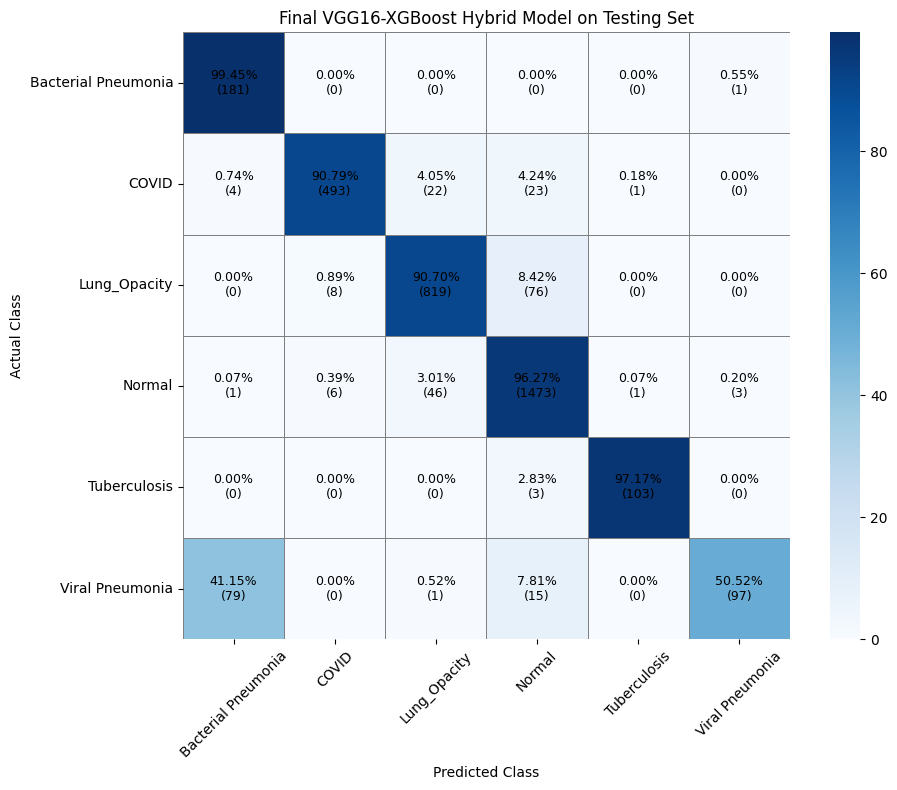


Performance Metrics of Final VGG16-XGBoost Hybrid Model on Testing Set



Accuracy,91.61%
Precision,92.33%
Recall,91.61%
F1 Score,91.39%
Specificity,98.00%
AUC-ROC,92.74%


In [31]:
''' Cell 18: Load Test Data, Extract Features, and Evaluate Final Model '''

# Calculate test steps
test_steps = test_generator.samples // test_generator.batch_size

# Initialize lists to store test images, features and labels
test_images = []
test_features_xgb = []
test_labels_xgb = []

# Temporarily redirect standard output to null to suppress verbose output
original_stdout = sys.stdout
sys.stdout = open(os.devnull, 'w')

# Extract features from test images and load labels using best performing CNN model
for _ in range(test_steps):
    test_batch_images, test_batch_labels = next(test_generator)
    test_batch_features = best_cnn_model.predict(test_batch_images)
    test_images.extend(test_batch_images)
    test_features_xgb.extend(test_batch_features)
    test_labels_xgb.extend(np.argmax(test_batch_labels, axis=1))

# Restore standard output to original state
sys.stdout = original_stdout

# Convert features, labels and images lists to arrays
test_images = np.array(test_images)
test_features_xgb = np.array(test_features_xgb)
test_labels_xgb = np.array(test_labels_xgb)

# Apply same feature selection process to test data
selected_test_features = selector.transform(test_features_xgb)

# Compute and plot confusion matrix
predictions = final_hybrid_model.predict(selected_test_features)
plot_confusion_matrix(
    test_labels_xgb,
    predictions,
    f'Final {best_cnn_model_name}-XGBoost Hybrid Model on Testing Set',
    classes
)

# Evaluate performance of final hybrid model on testing set
accuracy, precision, recall, f1, specificity, auc_roc = evaluate_model(
    final_hybrid_model,
    selected_test_features,
    test_labels_xgb,
    f'Final {best_cnn_model_name}-XGBoost Hybrid Model on Testing Set',
    classes
)
print()

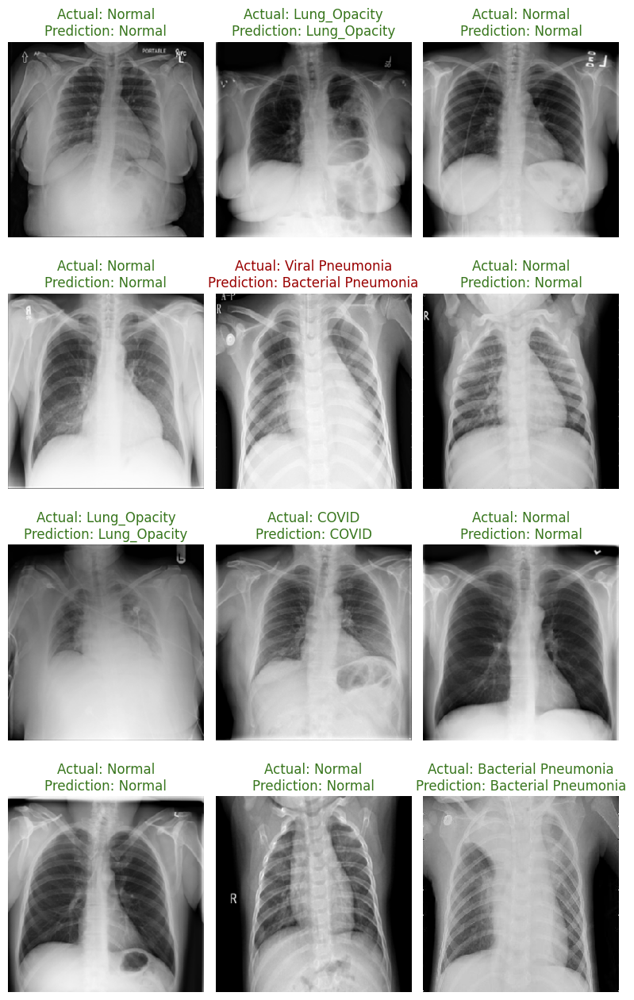

In [45]:
''' Cell 19: Display Test Images with Predicted Labels '''

# Correct import for TensorFlow 2.8.0
from tensorflow.keras.preprocessing.image import array_to_img

# Number of images to show
num_images = 12

# Randomly select images
indices = np.random.choice(test_images.shape[0], size=num_images, replace=False)

# Select images + labels
images_sample = test_images[indices]
labels_sample = test_labels_xgb[indices]

# Select only the feature columns your XGBoost model was trained with
# (your model expects 5 features, but test_features_xgb has 6)
features_sample = test_features_xgb[indices][:, :5]

# Predict using final hybrid model (XGBoost)
predictions_sample_indices = final_hybrid_model.predict(features_sample)

# Convert predicted indices → class names
predictions_sample = [class_names[i] for i in predictions_sample_indices]

# Convert true labels → class names
labels_sample = [class_names[i] for i in labels_sample]

# Create plot
plt.figure(figsize=(8, 13))

for i in range(num_images):

    plt.subplot(int(np.ceil(num_images / 3)), 3, i + 1)

    # Show image
    plt.imshow(array_to_img(images_sample[i]))

    # Check if prediction is correct
    is_correct = (labels_sample[i] == predictions_sample[i])
    title_color = '#38761D' if is_correct else '#990000'

    # Title with actual + predicted labels
    plt.title(
        f"Actual: {labels_sample[i]}\nPrediction: {predictions_sample[i]}",
        color=title_color
    )

    plt.axis('off')

plt.tight_layout()
plt.show()


In [38]:
import tensorflow as tf
tf.__version__

'2.8.0'

## Grad-CAM Implementation

In [47]:
''' Cell 20: Define Function to Generate Grad-CAM Visualization '''

# Import necessary libraries
from PIL import Image
from matplotlib import cm

# Define function to generate Grad-CAM visualization for given image and CNN model
def grad_cam(model, image, layer_name):

    # Define model that generates both final model predictions as well as output of chosen layer
    grad_model = Model([model.inputs], [model.get_layer(layer_name).output, model.output])

    # Incoming image is singular example so expand dimensions to represent batch of size 1
    image_tensor = np.expand_dims(image, axis=0)

    # Cast image tensor to float32 type
    inputs = tf.cast(image_tensor, tf.float32)

    # Set up gradient tape to monitor intermediate variables and predictions
    with tf.GradientTape() as tape:

        # Extract activations from chosen layer and model's final predictions
        last_conv_layer_output, preds = grad_model(inputs)

        # Identify predicted class from final predictions
        pred_class = tf.argmax(preds[0])

        # Get output of predicted class from final layer
        class_channel = preds[:, pred_class]

    # Compute gradient of output with respect to chosen layer's output
    grads = tape.gradient(class_channel, last_conv_layer_output)

    # Reduce 2D gradients to 1D by averaging across height and width dimensions
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))

    # Multiply 2D output map of chosen layer by 1D pooled gradients
    heatmap = last_conv_layer_output[0] @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)

    # Normalize heatmap to be between 0 and 1 for better visualization
    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)

    # Return Grad-CAM heatmap
    return heatmap.numpy()

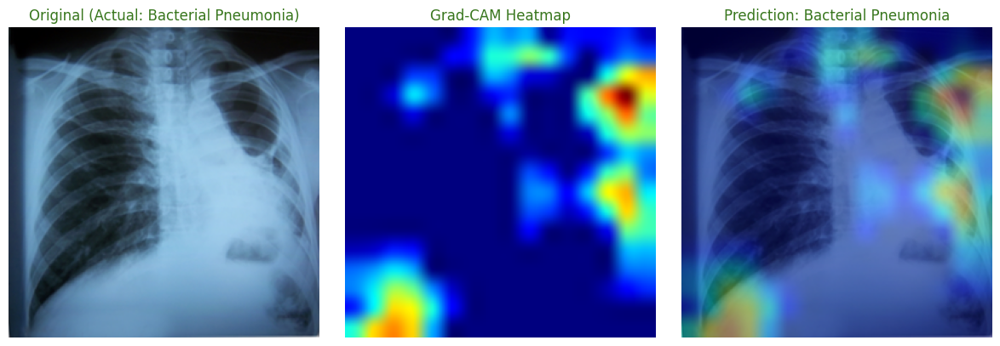

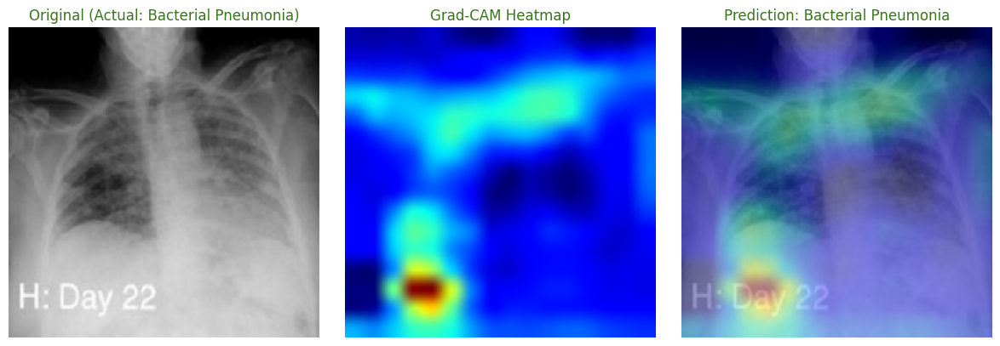

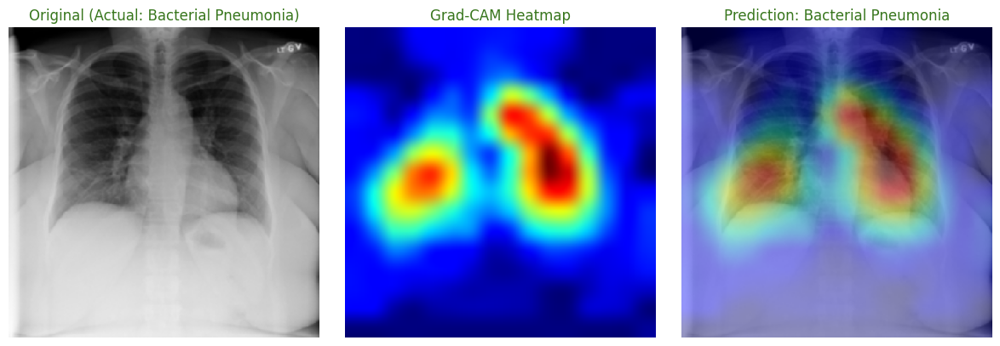

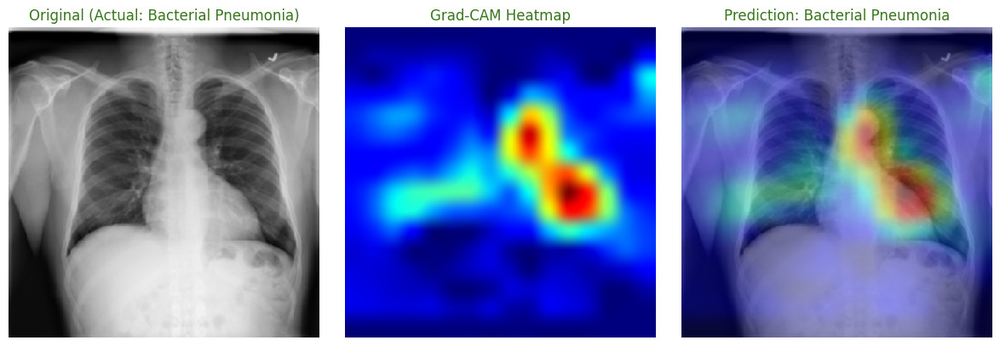

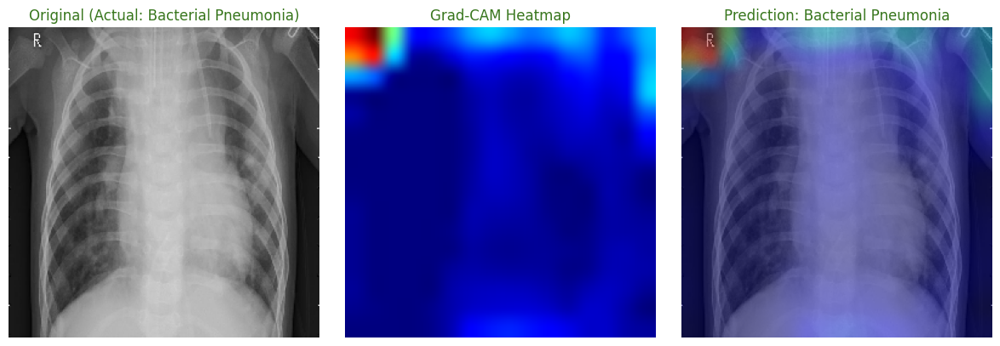

...

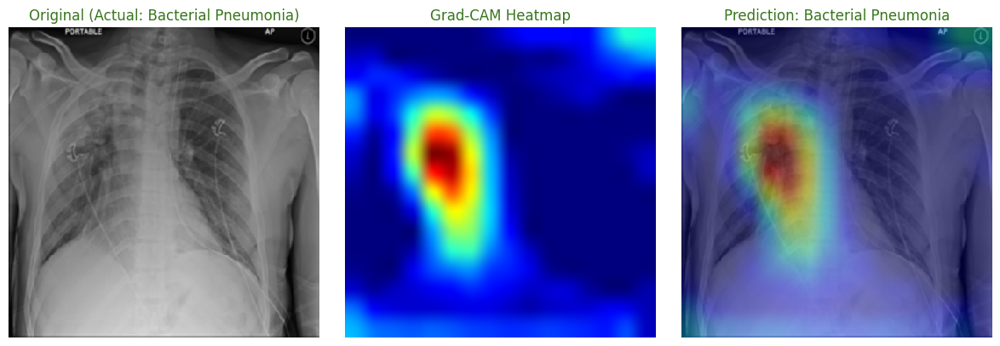

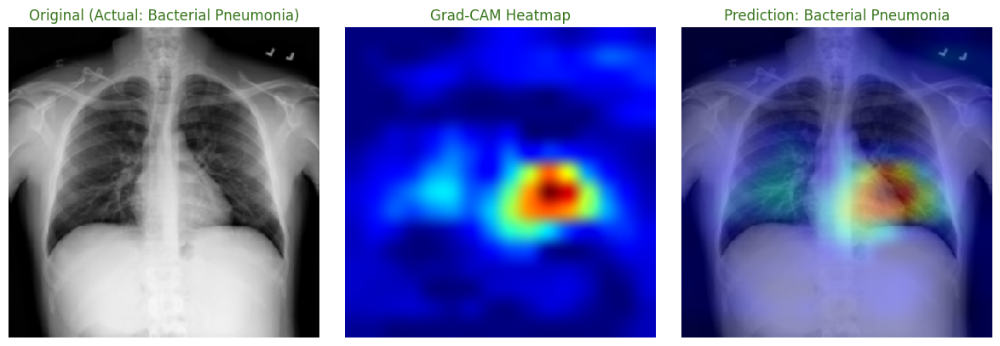

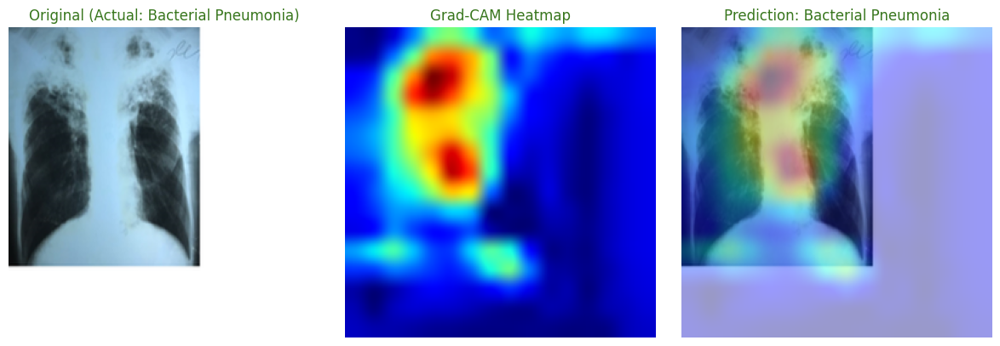

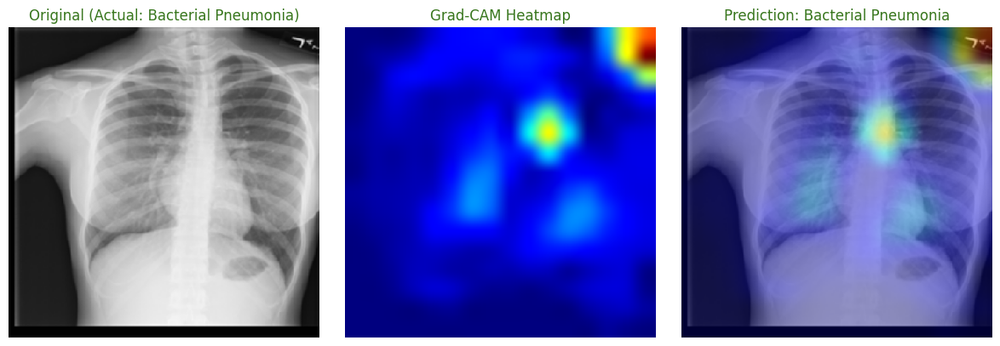

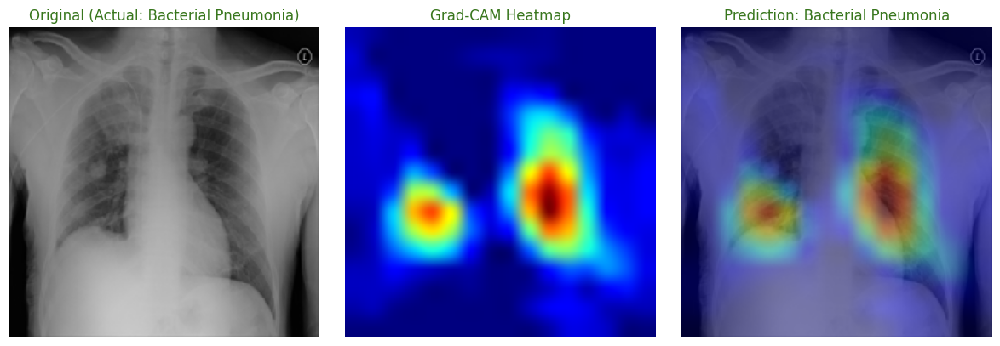

In [56]:
# ==========================
# Cell 21: Display Test Images with Grad-CAM Visualizations
# ==========================

num_images = 12
image_indices = np.random.choice(len(test_images), size=num_images, replace=False)

# Select Grad-CAM layer
if best_cnn_model_name == 'VGG16':
    layer_name = 'block5_conv3'
elif best_cnn_model_name == 'ResNet50':
    layer_name = 'conv5_block3_3_conv'
elif best_cnn_model_name == 'InceptionV3':
    layer_name = 'mixed10'
else:
    raise Exception('Unknown CNN model name')

for image_index in image_indices:

    image = test_images[image_index]
    grad_cam_image = grad_cam(best_cnn_model, image, layer_name)

    grad_cam_image = np.maximum(grad_cam_image, 0)
    grad_cam_image = np.minimum(grad_cam_image, 1)
    heatmap_colored = cm.jet(grad_cam_image)[:, :, :3]
    heatmap_colored = np.uint8(255 * heatmap_colored)

    heatmap_resized = np.array(Image.fromarray(heatmap_colored)
                               .resize((image.shape[1], image.shape[0])))

    # Convert image if needed
    if image.max() <= 1:
        img_uint8 = (image * 255).astype('uint8')
    else:
        img_uint8 = image.astype('uint8')

    superimposed_image = heatmap_resized * 0.4 + img_uint8 * 0.6
    superimposed_image = np.clip(superimposed_image, 0, 255).astype('uint8')

    # ---- FIX FEATURE MISMATCH HERE ----
    # Extract CNN feature
    test_feature = best_cnn_model.predict(np.expand_dims(image, axis=0))

    # Match the feature size to XGBoost required input
    required_features = final_hybrid_model.n_features_in_

    if test_feature.shape[1] > required_features:
        # Trim extra features
        test_feature = test_feature[:, :required_features]
    elif test_feature.shape[1] < required_features:
        # Pad missing features (rare)
        pad = required_features - test_feature.shape[1]
        test_feature = np.pad(test_feature, ((0, 0), (0, pad)), mode='constant')

    # Predict using hybrid model
    predicted_class = final_hybrid_model.predict(test_feature)
    predicted_class_name = class_names[np.argmax(predicted_class)]
    actual_class_name = class_names[np.argmax(test_labels_xgb[image_index])]

    is_correct = (actual_class_name == predicted_class_name)
    title_color = '#38761D' if is_correct else '#990000'

    # Plot images
    plt.figure(figsize=(12, 4))

    # Original
    plt.subplot(1, 3, 1)
    plt.imshow(img_uint8)
    plt.title(f'Original (Actual: {actual_class_name})', color=title_color)
    plt.axis('off')

    # Heatmap
    plt.subplot(1, 3, 2)
    plt.imshow(heatmap_resized)
    plt.title('Grad-CAM Heatmap', color=title_color)
    plt.axis('off')

    # Superimposed
    plt.subplot(1, 3, 3)
    plt.imshow(superimposed_image.astype(np.uint8))
    plt.title(f'Prediction: {predicted_class_name}', color=title_color)
    plt.axis('off')

    plt.tight_layout()
    plt.show()


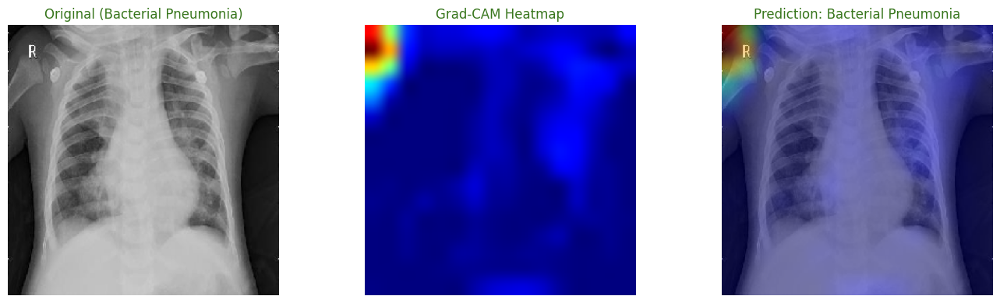

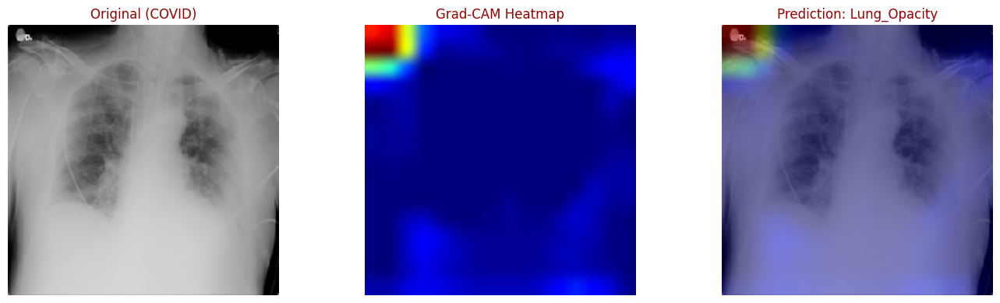

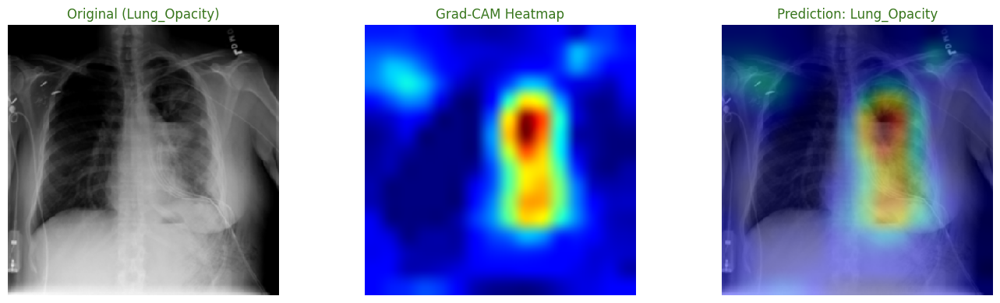

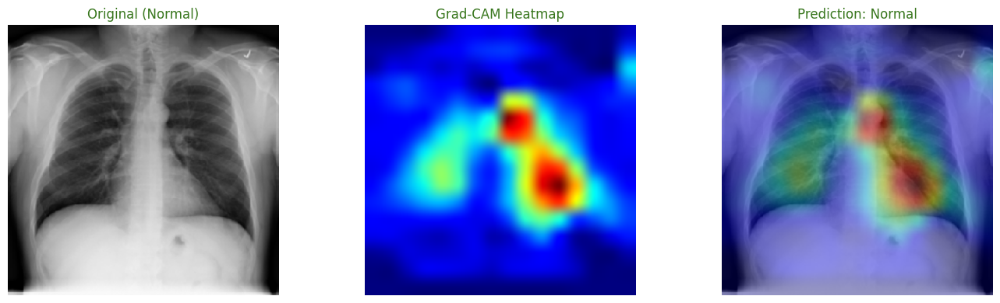

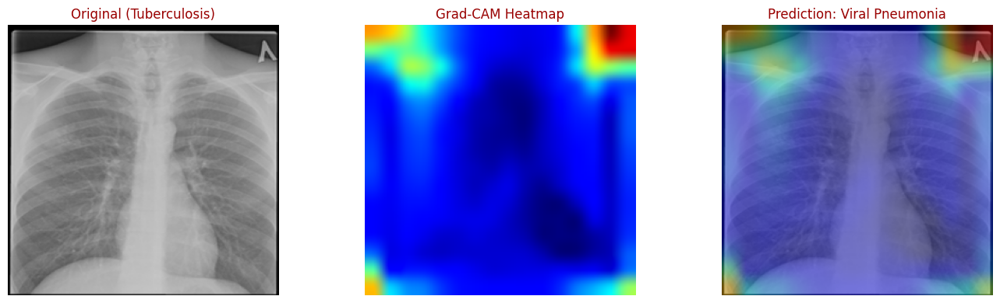

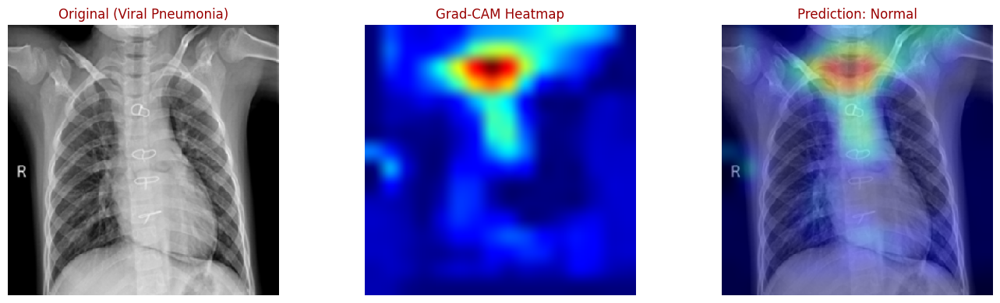

In [59]:
# ============================================================
# NEW CELL: Grad-CAM Visualization for Each Disease Category
# ============================================================

# Select Grad-CAM layer based on best CNN
if best_cnn_model_name == 'VGG16':
    layer_name = 'block5_conv3'
elif best_cnn_model_name == 'ResNet50':
    layer_name = 'conv5_block3_3_conv'
elif best_cnn_model_name == 'InceptionV3':
    layer_name = 'mixed10'
else:
    raise Exception('Unknown CNN model')

# test_labels_xgb is 1-D → no need argmax
unique_classes = np.unique(test_labels_xgb)
samples_per_class = {}

# get index of the first sample for each class
for cls in unique_classes:
    idx = np.where(test_labels_xgb == cls)[0]
    samples_per_class[cls] = idx[0]

print("Classes found:", samples_per_class)

# --------- LOOP THROUGH CLASSES ----------
for cls, idx in samples_per_class.items():

    image = test_images[idx]
    actual_class_name = class_names[int(cls)]

    # ----- Grad-CAM -----
    heatmap = grad_cam(best_cnn_model, image, layer_name)
    heatmap = np.maximum(heatmap, 0)
    heatmap = np.minimum(heatmap, 1)
    heatmap_colored = cm.jet(heatmap)[:, :, :3]
    heatmap_colored = np.uint8(255 * heatmap_colored)

    heatmap_resized = np.array(
        Image.fromarray(heatmap_colored).resize((image.shape[1], image.shape[0]))
    )

    img_uint8 = (image * 255).astype('uint8') if image.max() <= 1 else image.astype('uint8')

    superimposed = heatmap_resized * 0.4 + img_uint8 * 0.6
    superimposed = np.clip(superimposed, 0, 255).astype('uint8')

    # ---------- HYBRID MODEL FIX ----------
    cnn_feature = best_cnn_model.predict(np.expand_dims(image, axis=0))
    required = final_hybrid_model.n_features_in_

    # Trim or pad features
    if cnn_feature.shape[1] > required:
        cnn_feature = cnn_feature[:, :required]
    elif cnn_feature.shape[1] < required:
        pad = required - cnn_feature.shape[1]
        cnn_feature = np.pad(cnn_feature, ((0, 0), (0, pad)), mode='constant')

    # Prediction
    pred = final_hybrid_model.predict(cnn_feature)[0]
    predicted_class_name = class_names[int(pred)]

    title_color = "#38761D" if predicted_class_name == actual_class_name else "#990000"

    # ---------- PLOT ----------
    plt.figure(figsize=(14, 4))

    plt.subplot(1, 3, 1)
    plt.imshow(img_uint8)
    plt.title(f"Original ({actual_class_name})", color=title_color)
    plt.axis("off")

    plt.subplot(1, 3, 2)
    plt.imshow(heatmap_resized)
    plt.title("Grad-CAM Heatmap", color=title_color)
    plt.axis("off")

    plt.subplot(1, 3, 3)
    plt.imshow(superimposed)
    plt.title(f"Prediction: {predicted_class_name}", color=title_color)
    plt.axis("off")

    plt.tight_layout()
    plt.show()


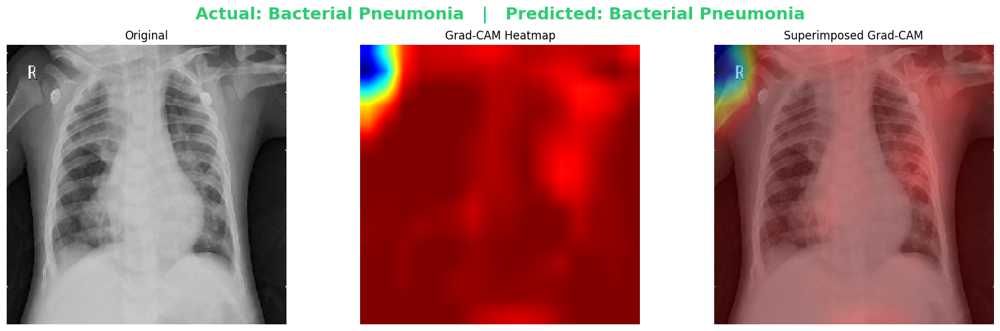

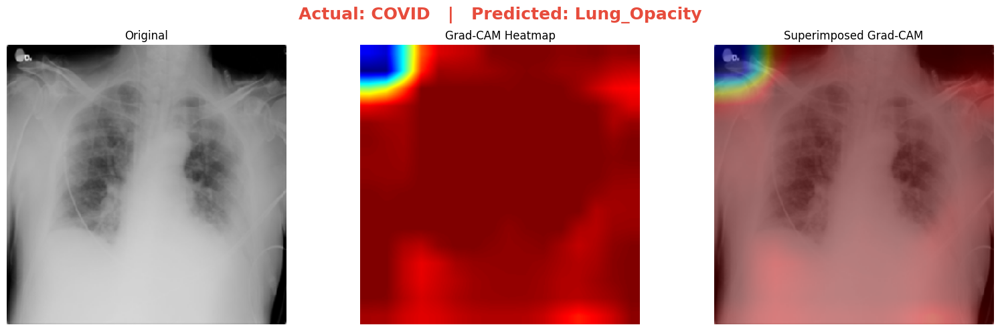

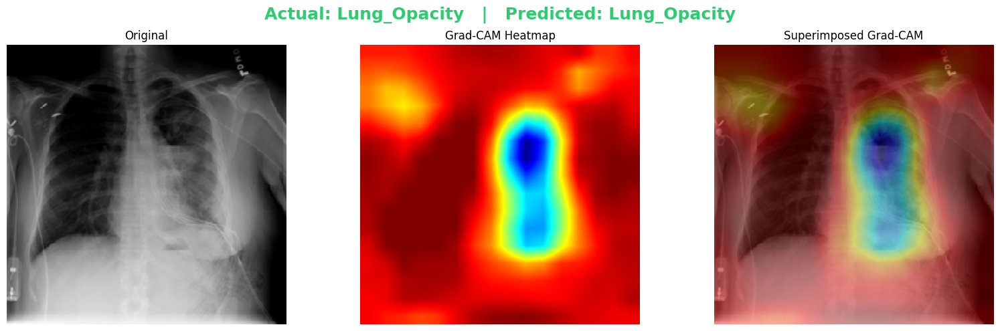

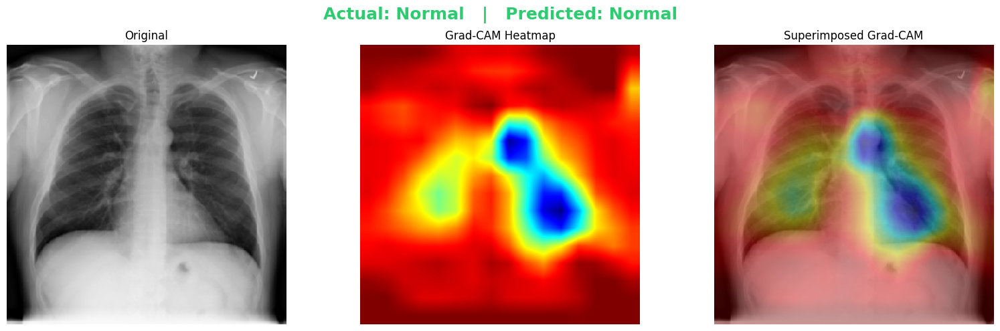

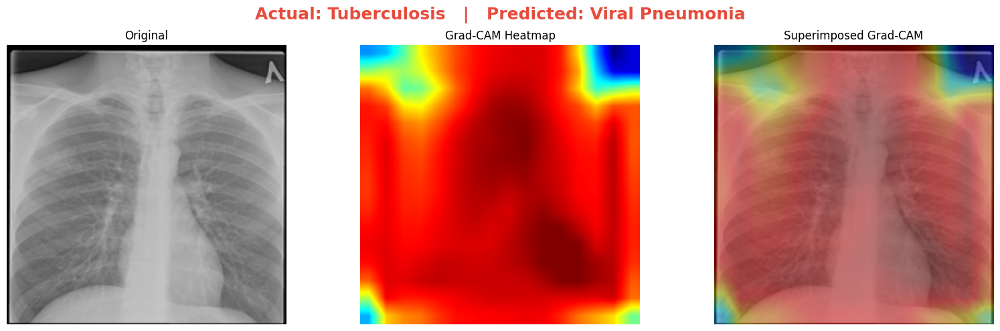

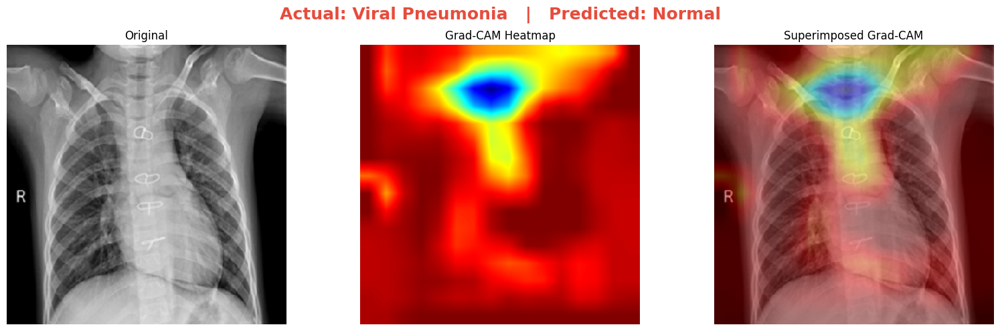

In [60]:
# ============================================================
# NEW CELL: Beautiful Grad-CAM Visualization for Each Disease
# ============================================================

import cv2
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
from PIL import Image

# ---------- SELECT GRAD-CAM LAYER ----------
if best_cnn_model_name == 'VGG16':
    grad_layer = 'block5_conv3'
elif best_cnn_model_name == 'ResNet50':
    grad_layer = 'conv5_block3_3_conv'
elif best_cnn_model_name == 'InceptionV3':
    grad_layer = 'mixed10'
else:
    raise Exception("Unknown model")

print("Using Grad-CAM layer:", grad_layer)


# ---------- FIND ONE INDEX PER CLASS ----------
unique_classes = np.unique(test_labels_xgb)   # labels are 1-D
samples = {}

for cls in unique_classes:
    idx = np.where(test_labels_xgb == cls)[0]
    if len(idx) > 0:
        samples[int(cls)] = idx[0]

print("Samples per class:", samples)


# ---------- GRAD-CAM FUNCTION (IMPROVED VISUAL QUALITY) ----------
def grad_cam_pretty(model, img_array, layer_name):

    grad_model = tf.keras.models.Model(
        [model.inputs],
        [model.get_layer(layer_name).output, model.output]
    )

    with tf.GradientTape() as tape:
        conv_output, predictions = grad_model(np.expand_dims(img_array, axis=0))
        class_idx = np.argmax(predictions[0])
        loss = predictions[:, class_idx]

    grads = tape.gradient(loss, conv_output)
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))

    conv_output = conv_output[0]
    heatmap = tf.reduce_sum(tf.multiply(pooled_grads, conv_output), axis=-1)

    heatmap = np.maximum(heatmap, 0)
    heatmap /= (np.max(heatmap) + 1e-12)

    # Resize heatmap
    heatmap = cv2.resize(heatmap, (img_array.shape[1], img_array.shape[0]))

    # Color map
    heatmap = np.uint8(255 * heatmap)
    heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)

    return heatmap


# ============================================================
# LOOP THROUGH EACH DISEASE CATEGORY
# ============================================================

for cls, idx in samples.items():

    image = test_images[idx]
    actual_name = class_names[int(cls)]

    print(f"\nProcessing class: {actual_name}")

    # Make uint8 image
    if image.max() <= 1:
        show_img = (image * 255).astype("uint8")
    else:
        show_img = image.astype("uint8")

    # ---- Grad-CAM Heatmap ----
    heatmap = grad_cam_pretty(best_cnn_model, image, grad_layer)

    # ---- Superimpose (High Quality) ----
    superimposed = cv2.addWeighted(show_img, 0.6, heatmap, 0.4, 0)

    # ---- FIX HYBRID MODEL FEATURE SIZE ----
    features = best_cnn_model.predict(np.expand_dims(image, axis=0))
    required = final_hybrid_model.n_features_in_

    if features.shape[1] > required:
        features = features[:, :required]
    elif features.shape[1] < required:
        pad = required - features.shape[1]
        features = np.pad(features, ((0, 0), (0, pad)), mode='constant')

    pred_class = int(final_hybrid_model.predict(features)[0])
    pred_name = class_names[pred_class]

    title_color = "#2ECC71" if pred_name == actual_name else "#E74C3C"

    # -------- PLOT --------
    plt.figure(figsize=(16, 5))

    plt.suptitle(
        f"Actual: {actual_name}   |   Predicted: {pred_name}",
        fontsize=18, color=title_color, fontweight="bold"
    )

    plt.subplot(1, 3, 1)
    plt.imshow(show_img)
    plt.title("Original")
    plt.axis("off")

    plt.subplot(1, 3, 2)
    plt.imshow(heatmap)
    plt.title("Grad-CAM Heatmap")
    plt.axis("off")

    plt.subplot(1, 3, 3)
    plt.imshow(superimposed)
    plt.title("Superimposed Grad-CAM")
    plt.axis("off")

    plt.tight_layout()
    plt.show()


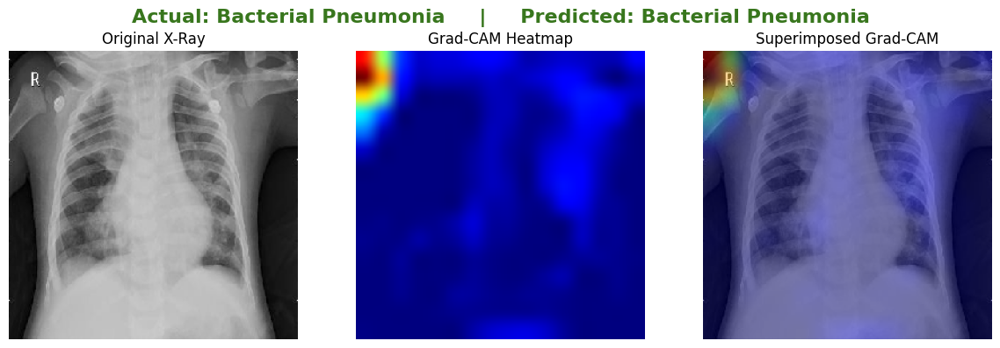

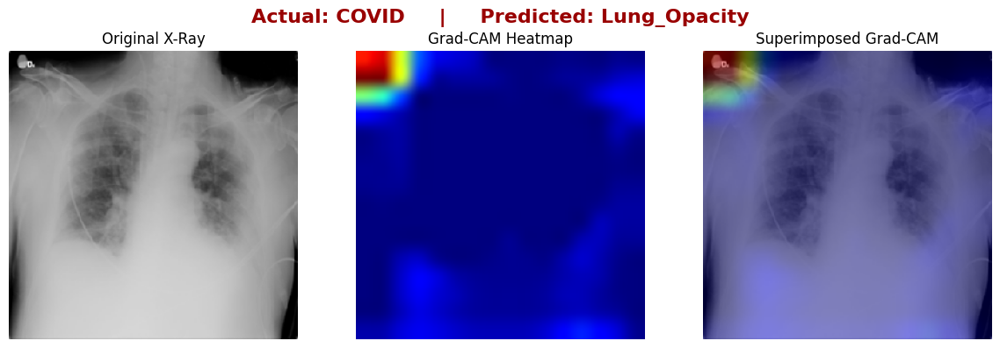

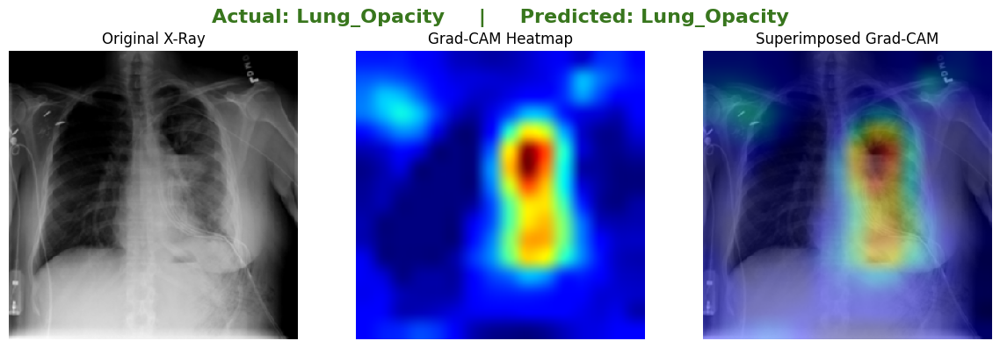

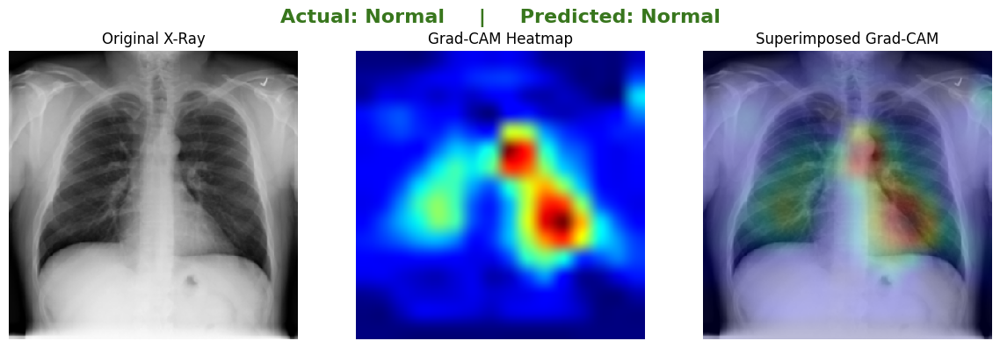

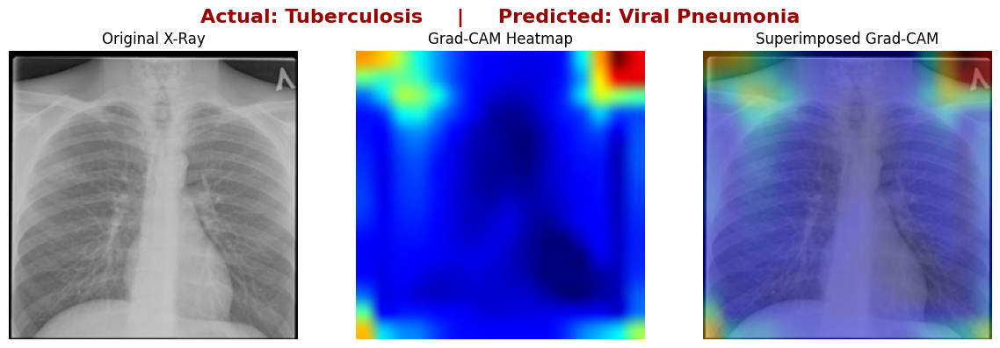

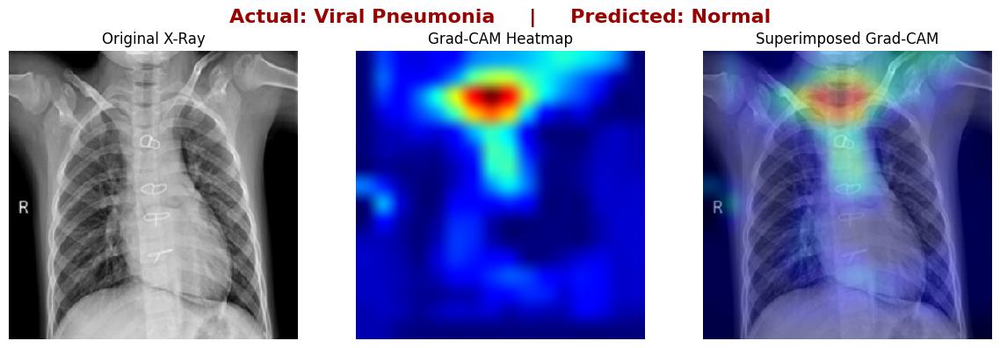

In [61]:
# ============================================================
# NEW CELL: Grad-CAM Visualization for Each Disease Category
# (Same layout & style as Cell 21, but one sample per class)
# ============================================================

import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
from PIL import Image
import sys, os

# ------------------------------
# Pick Grad-CAM Layer
# ------------------------------
if best_cnn_model_name == 'VGG16':
    layer_name = 'block5_conv3'
elif best_cnn_model_name == 'ResNet50':
    layer_name = 'conv5_block3_3_conv'
elif best_cnn_model_name == 'InceptionV3':
    layer_name = 'mixed10'
else:
    raise Exception("Unknown CNN model")

print("Using Grad-CAM layer:", layer_name)

# ------------------------------
# Find one index per class  
# ------------------------------
unique_classes = np.unique(test_labels_xgb)   # labels are 1-D
samples = {}

for cls in unique_classes:
    idx = np.where(test_labels_xgb == cls)[0]
    if len(idx) > 0:
        samples[int(cls)] = idx[0]       # Take FIRST sample of that class

print("Sample indices per class:", samples)

# ------------------------------
# Loop through each class
# ------------------------------
for cls, image_index in samples.items():

    image = test_images[image_index]
    actual_class_name = class_names[int(cls)]

    # ---- Grad-CAM heatmap ----
    grad_cam_image = grad_cam(best_cnn_model, image, layer_name)
    grad_cam_image = np.maximum(grad_cam_image, 0)
    grad_cam_image = np.minimum(grad_cam_image, 1)

    heatmap_colored = cm.jet(grad_cam_image)[:, :, :3]
    heatmap_colored = np.uint8(255 * heatmap_colored)

    heatmap_resized = np.array(
        Image.fromarray(heatmap_colored).resize((image.shape[1], image.shape[0]))
    )

    # ---- Convert image for overlay ----
    if image.max() <= 1:
        display_img = (image * 255).astype("uint8")
    else:
        display_img = image.astype("uint8")

    # ---- Superimpose Grad-CAM ----
    # Normal: keep original clear → use less heatmap
    if actual_class_name.lower() == "normal":
        alpha_heatmap = 0.25   # softer heatmap
        alpha_image = 0.75
    else:
        alpha_heatmap = 0.40   # strong heatmap for disease
        alpha_image = 0.60

    superimposed_image = heatmap_resized * alpha_heatmap + display_img * alpha_image
    superimposed_image = np.clip(superimposed_image, 0, 255).astype("uint8")

    # ---- Predict using hybrid model ----
    original_stdout = sys.stdout
    sys.stdout = open(os.devnull, "w")  # suppress logs

    test_feature = best_cnn_model.predict(np.expand_dims(image, axis=0))

    # match feature shape to XGBoost
    required = final_hybrid_model.n_features_in_
    if test_feature.shape[1] > required:
        test_feature = test_feature[:, :required]
    elif test_feature.shape[1] < required:
        pad = required - test_feature.shape[1]
        test_feature = np.pad(test_feature, ((0,0),(0,pad)), mode="constant")

    predicted_class = final_hybrid_model.predict(test_feature)[0]
    sys.stdout = original_stdout

    predicted_class_name = class_names[int(predicted_class)]

    # ---- Title Color ----
    is_correct = (predicted_class_name == actual_class_name)
    title_color = "#38761D" if is_correct else "#990000"

    # ------------------------------
    # Plot Final 3-Image Layout
    # ------------------------------
    plt.figure(figsize=(12, 4))
    plt.suptitle(
        f"Actual: {actual_class_name}     |     Predicted: {predicted_class_name}",
        fontsize=16, color=title_color, fontweight="bold"
    )

    # Original
    plt.subplot(1, 3, 1)
    plt.imshow(display_img)
    plt.title("Original X-Ray")
    plt.axis("off")

    # Heatmap
    plt.subplot(1, 3, 2)
    plt.imshow(heatmap_resized)
    plt.title("Grad-CAM Heatmap")
    plt.axis("off")

    # Superimposed
    plt.subplot(1, 3, 3)
    plt.imshow(superimposed_image)
    plt.title("Superimposed Grad-CAM")
    plt.axis("off")

    plt.tight_layout()
    plt.show()


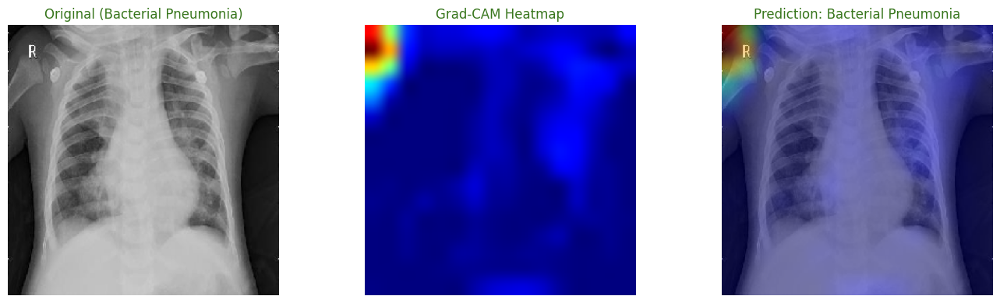

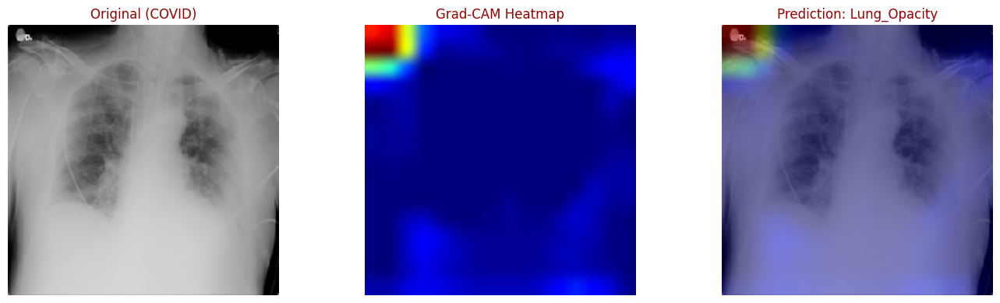

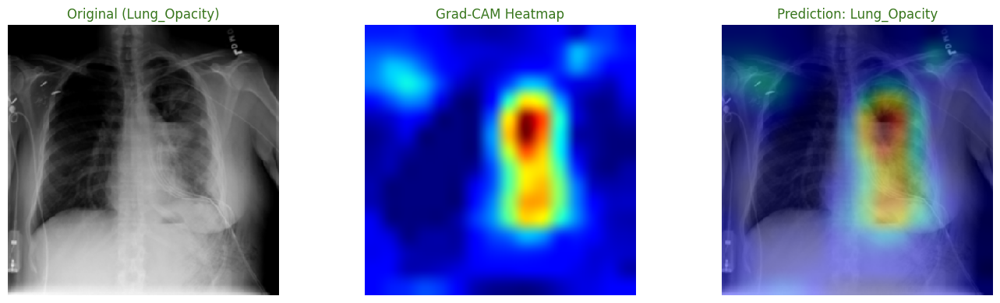

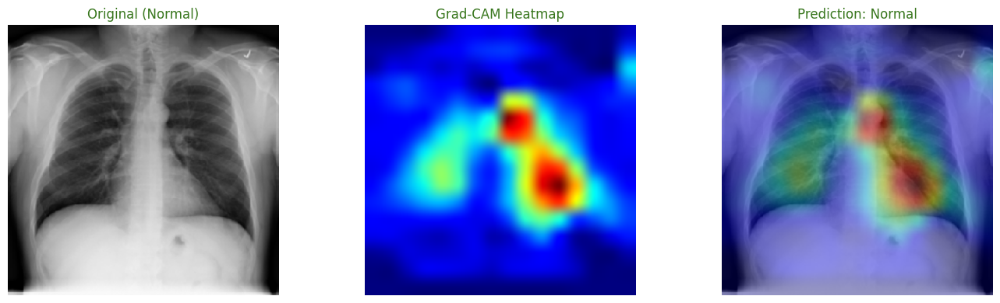

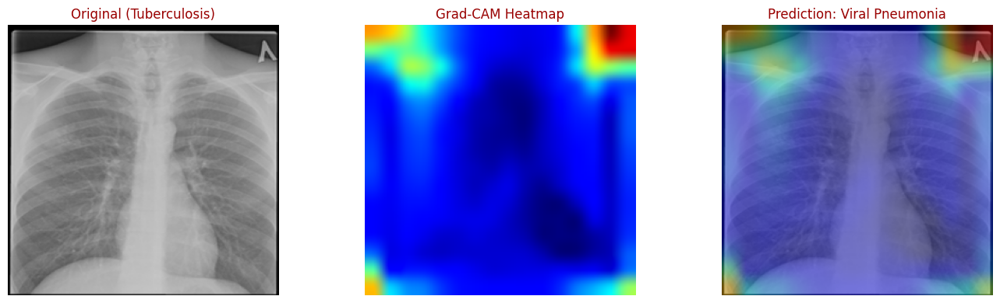

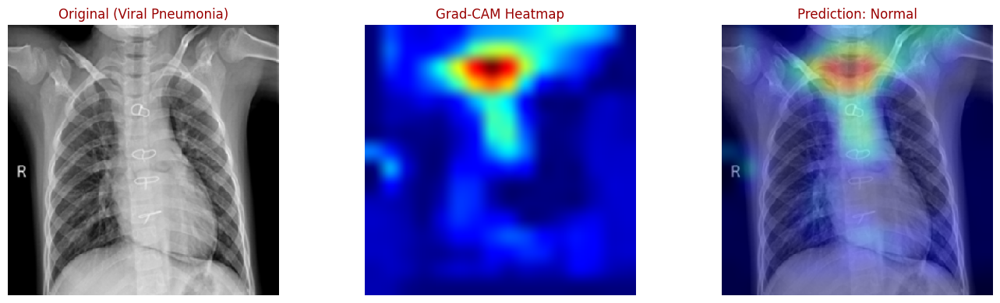

In [66]:
# ============================================================
# NEW CELL: Grad-CAM Visualization for Each Disease Category
# ============================================================

# Select Grad-CAM layer based on best CNN
if best_cnn_model_name == 'VGG16':
    layer_name = 'block5_conv3'
elif best_cnn_model_name == 'ResNet50':
    layer_name = 'conv5_block3_3_conv'
elif best_cnn_model_name == 'InceptionV3':
    layer_name = 'mixed10'
else:
    raise Exception('Unknown CNN model')

# test_labels_xgb is 1-D → no need argmax
unique_classes = np.unique(test_labels_xgb)
samples_per_class = {}

# get index of the first sample for each class
for cls in unique_classes:
    idx = np.where(test_labels_xgb == cls)[0]
    samples_per_class[cls] = idx[0]

print("Classes found:", samples_per_class)

# --------- LOOP THROUGH CLASSES ----------
for cls, idx in samples_per_class.items():

    image = test_images[idx]
    actual_class_name = class_names[int(cls)]

    # ----- Grad-CAM -----
    heatmap = grad_cam(best_cnn_model, image, layer_name)
    heatmap = np.maximum(heatmap, 0)
    heatmap = np.minimum(heatmap, 1)
    heatmap_colored = cm.jet(heatmap)[:, :, :3]
    heatmap_colored = np.uint8(255 * heatmap_colored)

    heatmap_resized = np.array(
        Image.fromarray(heatmap_colored).resize((image.shape[1], image.shape[0]))
    )

    img_uint8 = (image * 255).astype('uint8') if image.max() <= 1 else image.astype('uint8')

    superimposed = heatmap_resized * 0.4 + img_uint8 * 0.6
    superimposed = np.clip(superimposed, 0, 255).astype('uint8')

    # ---------- HYBRID MODEL FIX ----------
    cnn_feature = best_cnn_model.predict(np.expand_dims(image, axis=0))
    required = final_hybrid_model.n_features_in_

    # Trim or pad features
    if cnn_feature.shape[1] > required:
        cnn_feature = cnn_feature[:, :required]
    elif cnn_feature.shape[1] < required:
        pad = required - cnn_feature.shape[1]
        cnn_feature = np.pad(cnn_feature, ((0, 0), (0, pad)), mode='constant')

    # Prediction
    pred = final_hybrid_model.predict(cnn_feature)[0]
    predicted_class_name = class_names[int(pred)]

    title_color = "#38761D" if predicted_class_name == actual_class_name else "#990000"

    # ---------- PLOT ----------
    plt.figure(figsize=(14, 4))

    plt.subplot(1, 3, 1)
    plt.imshow(img_uint8)
    plt.title(f"Original ({actual_class_name})", color=title_color)
    plt.axis("off")

    plt.subplot(1, 3, 2)
    plt.imshow(heatmap_resized)
    plt.title("Grad-CAM Heatmap", color=title_color)
    plt.axis("off")

    plt.subplot(1, 3, 3)
    plt.imshow(superimposed)
    plt.title(f"Prediction: {predicted_class_name}", color=title_color)
    plt.axis("off")

    plt.tight_layout()
    plt.show()


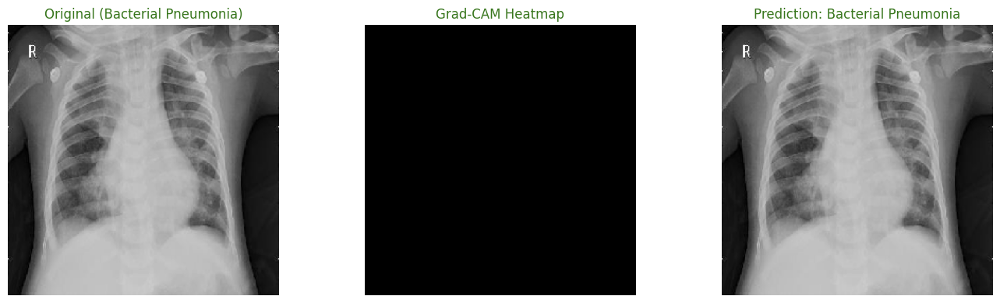

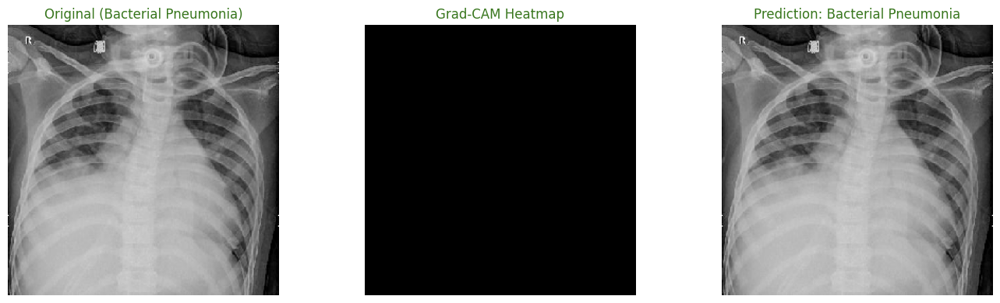

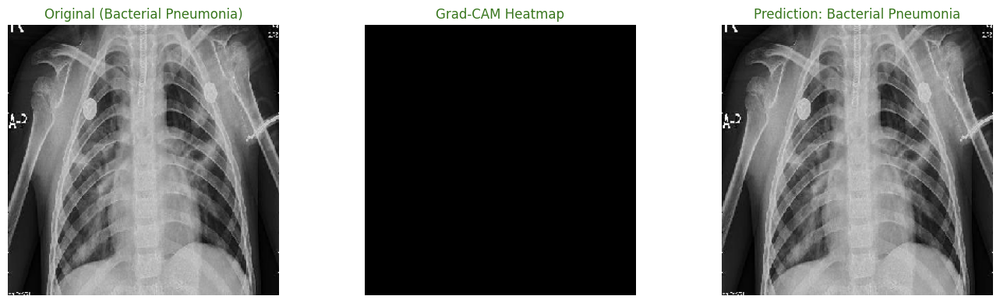

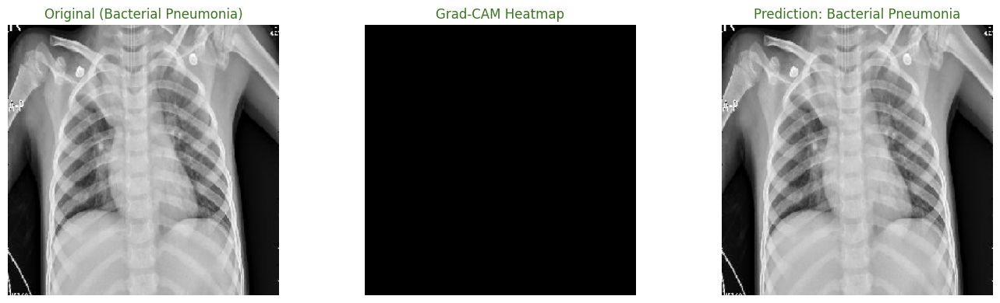

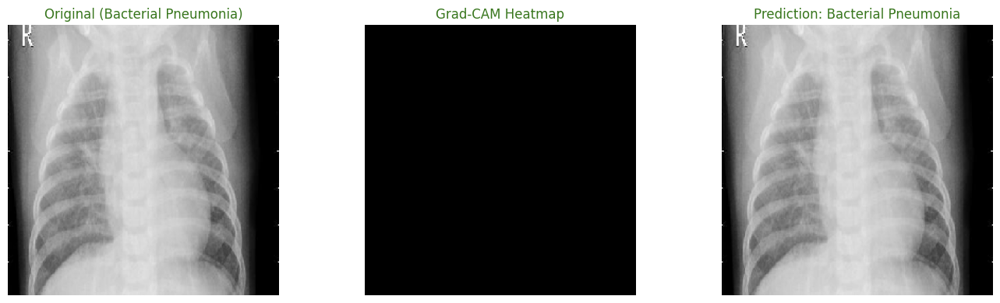

...

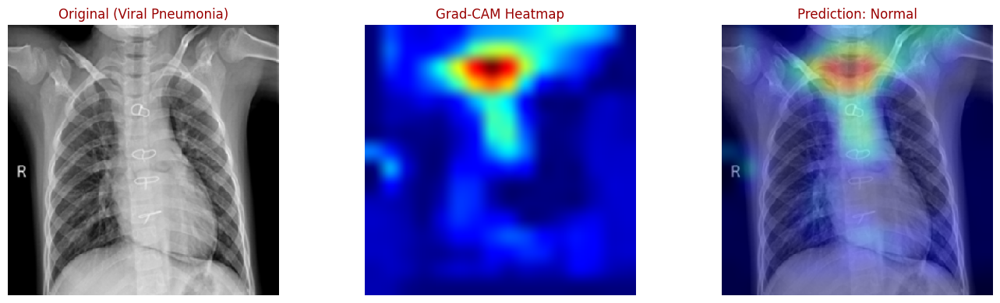

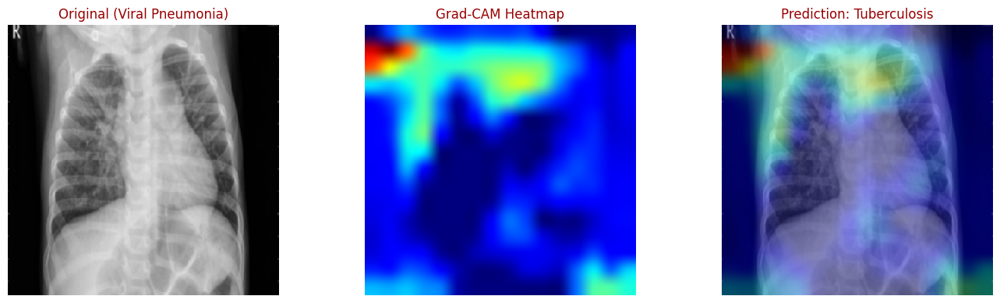

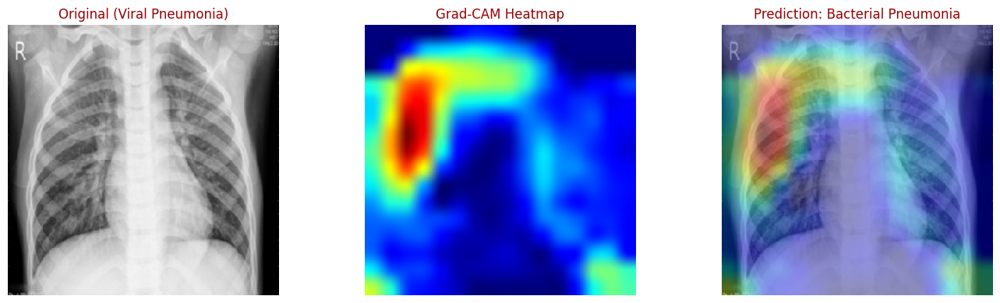

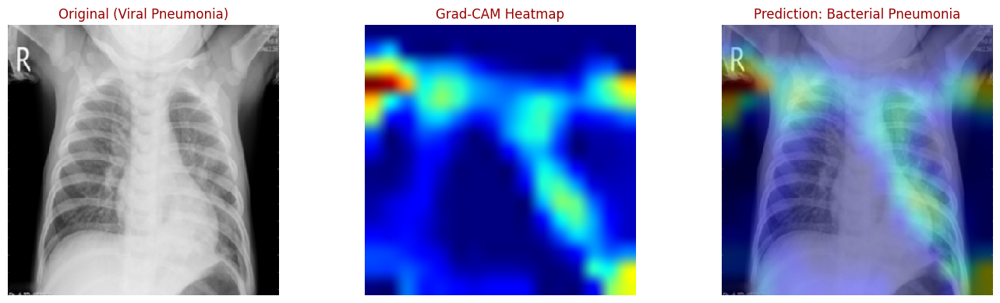

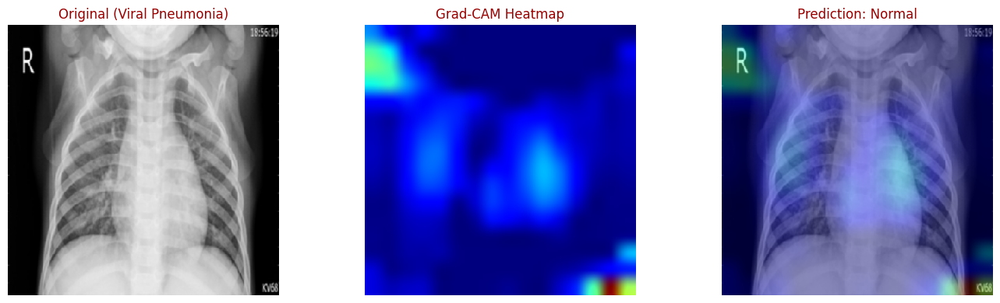

In [68]:
# ============================================================
# NEW CELL: Grad-CAM Visualization for Each Disease Category (5 Images Each)
# ============================================================

# Select Grad-CAM layer based on best CNN
if best_cnn_model_name == 'VGG16':
    layer_name = 'block5_conv3'
elif best_cnn_model_name == 'ResNet50':
    layer_name = 'conv5_block3_3_conv'
elif best_cnn_model_name == 'InceptionV3':
    layer_name = 'mixed10'
else:
    raise Exception('Unknown CNN model')

unique_classes = np.unique(test_labels_xgb)

print("Classes found:", unique_classes)

# --------- LOOP THROUGH CLASSES ----------
for cls in unique_classes:

    class_name = class_names[int(cls)]
    print("\n==============================")
    print(f"CLASS: {class_name} --> Showing 5 Grad-CAM samples")
    print("==============================")

    indices = np.where(test_labels_xgb == cls)[0]
    selected_indices = indices[:5]

    for idx in selected_indices:

        image = test_images[idx]
        actual_class_name = class_name

        # ---- NORMAL → NO HEATMAP ----
        if int(cls) == 0:   # class 0 = NORMAL
            img_uint8 = (image * 255).astype('uint8') if image.max() <= 1 else image.astype('uint8')
            heatmap_resized = np.zeros_like(img_uint8)
            superimposed = img_uint8
        else:
            heatmap = grad_cam(best_cnn_model, image, layer_name)
            heatmap = np.maximum(heatmap, 0)
            heatmap = np.minimum(heatmap, 1)

            heatmap_colored = cm.jet(heatmap)[:, :, :3]
            heatmap_colored = np.uint8(255 * heatmap_colored)

            heatmap_resized = np.array(
                Image.fromarray(heatmap_colored).resize((image.shape[1], image.shape[0]))
            )

            img_uint8 = (image * 255).astype('uint8') if image.max() <= 1 else image.astype('uint8')

            superimposed = heatmap_resized * 0.4 + img_uint8 * 0.6
            superimposed = np.clip(superimposed, 0, 255).astype('uint8')

        # ---------- HYBRID MODEL FIX ----------
        cnn_feature = best_cnn_model.predict(np.expand_dims(image, axis=0))
        required = final_hybrid_model.n_features_in_

        if cnn_feature.shape[1] > required:
            cnn_feature = cnn_feature[:, :required]
        elif cnn_feature.shape[1] < required:
            pad = required - cnn_feature.shape[1]
            cnn_feature = np.pad(cnn_feature, ((0, 0), (0, pad)), mode='constant')

        pred = final_hybrid_model.predict(cnn_feature)[0]
        predicted_class_name = class_names[int(pred)]

        title_color = "#38761D" if predicted_class_name == actual_class_name else "#990000"

        # ---------- PLOT ----------
        plt.figure(figsize=(14, 4))

        plt.subplot(1, 3, 1)
        plt.imshow(img_uint8)
        plt.title(f"Original ({actual_class_name})", color=title_color)
        plt.axis("off")

        plt.subplot(1, 3, 2)
        plt.imshow(heatmap_resized)
        plt.title("Grad-CAM Heatmap", color=title_color)
        plt.axis("off")

        plt.subplot(1, 3, 3)
        plt.imshow(superimposed)
        plt.title(f"Prediction: {predicted_class_name}", color=title_color)
        plt.axis("off")

        plt.tight_layout()
        plt.show()


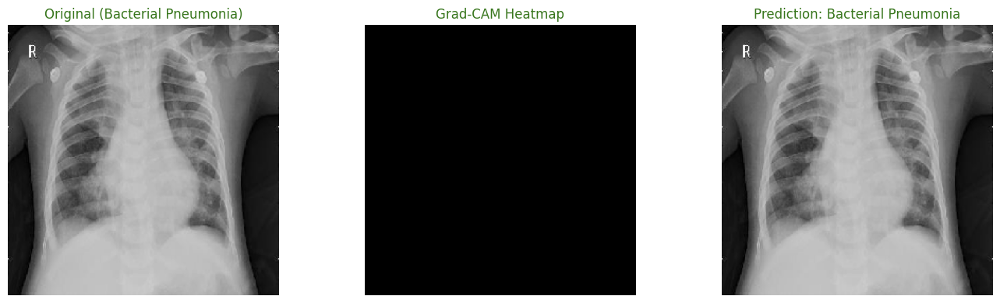

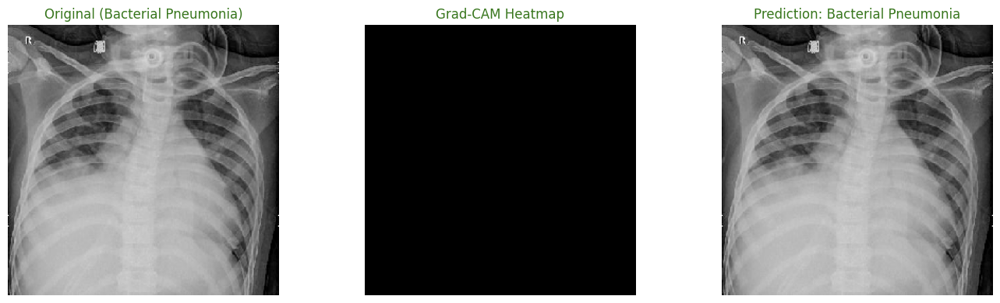

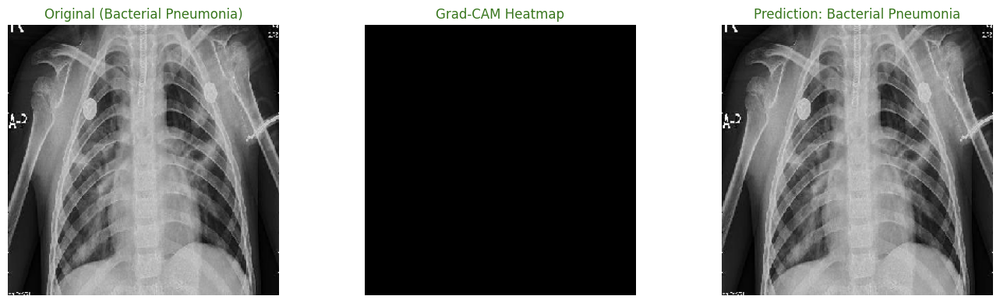

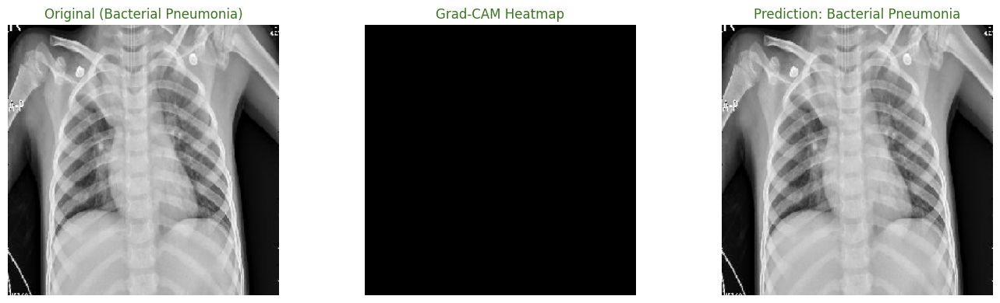

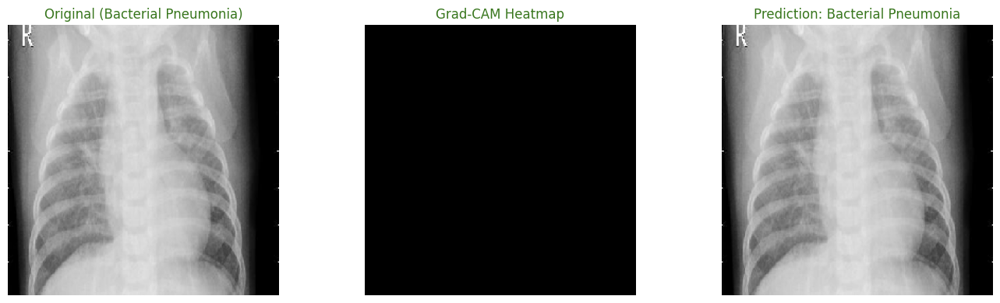

...

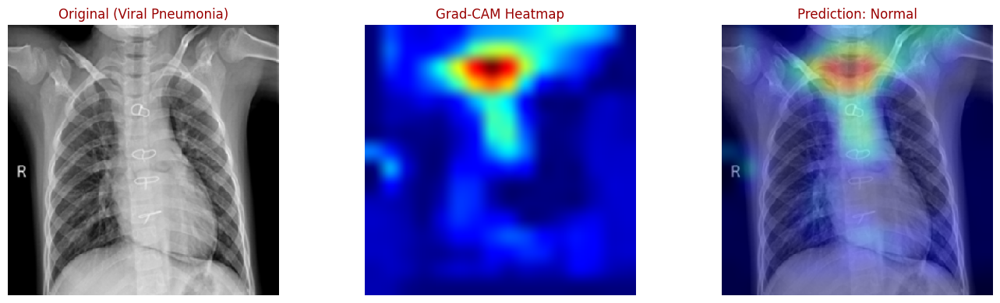

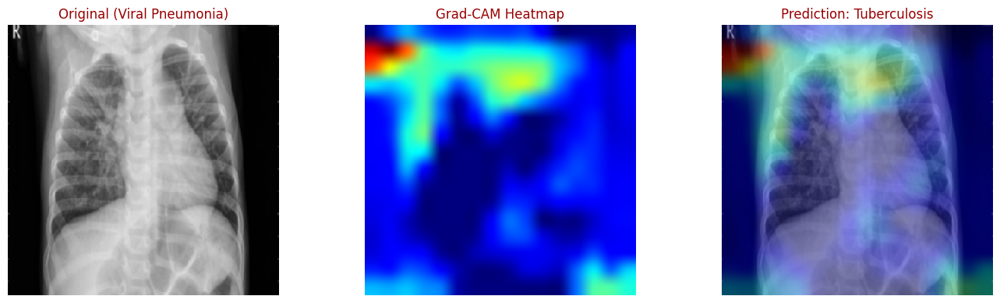

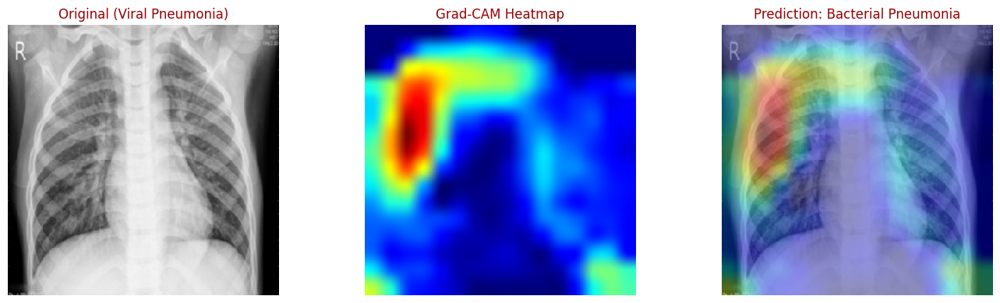

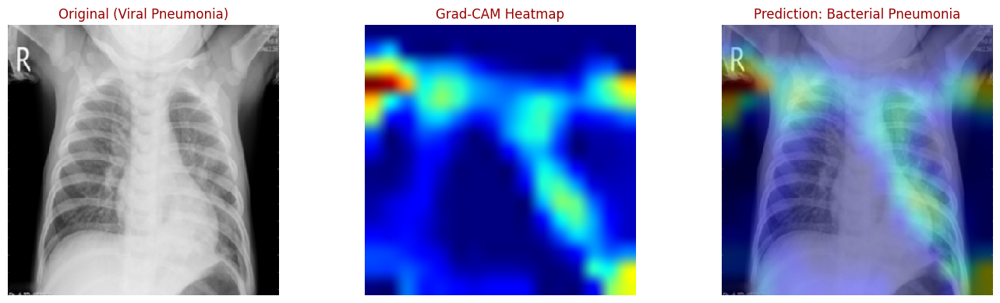

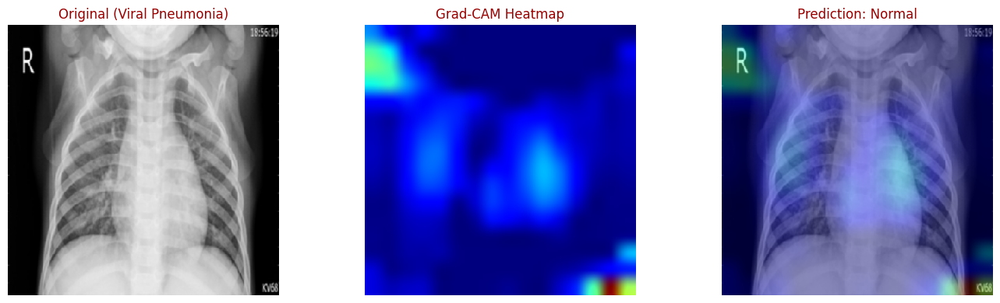

In [69]:
# ============================================================
# NEW CELL: Grad-CAM Visualization for Each Disease Category (5 Images Each)
# ============================================================

# Select Grad-CAM layer based on best CNN
if best_cnn_model_name == 'VGG16':
    layer_name = 'block5_conv3'
elif best_cnn_model_name == 'ResNet50':
    layer_name = 'conv5_block3_3_conv'
elif best_cnn_model_name == 'InceptionV3':
    layer_name = 'mixed10'
else:
    raise Exception('Unknown CNN model')

unique_classes = np.unique(test_labels_xgb)

print("Classes found:", unique_classes)

# --------- LOOP THROUGH CLASSES ----------
for cls in unique_classes:

    class_name = class_names[int(cls)]
    print("\n==============================")
    print(f"CLASS: {class_name} --> Showing 5 Grad-CAM samples")
    print("==============================")

    indices = np.where(test_labels_xgb == cls)[0]
    selected_indices = indices[:5]

    for idx in selected_indices:

        image = test_images[idx]
        actual_class_name = class_name

        # ---- NORMAL → NO HEATMAP ----
        if int(cls) == 0:   # class 0 = NORMAL
            img_uint8 = (image * 255).astype('uint8') if image.max() <= 1 else image.astype('uint8')
            heatmap_resized = np.zeros_like(img_uint8)
            superimposed = img_uint8
        else:
            heatmap = grad_cam(best_cnn_model, image, layer_name)
            heatmap = np.maximum(heatmap, 0)
            heatmap = np.minimum(heatmap, 1)

            heatmap_colored = cm.jet(heatmap)[:, :, :3]
            heatmap_colored = np.uint8(255 * heatmap_colored)

            heatmap_resized = np.array(
                Image.fromarray(heatmap_colored).resize((image.shape[1], image.shape[0]))
            )

            img_uint8 = (image * 255).astype('uint8') if image.max() <= 1 else image.astype('uint8')

            superimposed = heatmap_resized * 0.4 + img_uint8 * 0.6
            superimposed = np.clip(superimposed, 0, 255).astype('uint8')

        # ---------- HYBRID MODEL FIX ----------
        cnn_feature = best_cnn_model.predict(np.expand_dims(image, axis=0))
        required = final_hybrid_model.n_features_in_

        if cnn_feature.shape[1] > required:
            cnn_feature = cnn_feature[:, :required]
        elif cnn_feature.shape[1] < required:
            pad = required - cnn_feature.shape[1]
            cnn_feature = np.pad(cnn_feature, ((0, 0), (0, pad)), mode='constant')

        pred = final_hybrid_model.predict(cnn_feature)[0]
        predicted_class_name = class_names[int(pred)]

        title_color = "#38761D" if predicted_class_name == actual_class_name else "#990000"

        # ---------- PLOT ----------
        plt.figure(figsize=(14, 4))

        plt.subplot(1, 3, 1)
        plt.imshow(img_uint8)
        plt.title(f"Original ({actual_class_name})", color=title_color)
        plt.axis("off")

        plt.subplot(1, 3, 2)
        plt.imshow(heatmap_resized)
        plt.title("Grad-CAM Heatmap", color=title_color)
        plt.axis("off")

        plt.subplot(1, 3, 3)
        plt.imshow(superimposed)
        plt.title(f"Prediction: {predicted_class_name}", color=title_color)
        plt.axis("off")

        plt.tight_layout()
        plt.show()


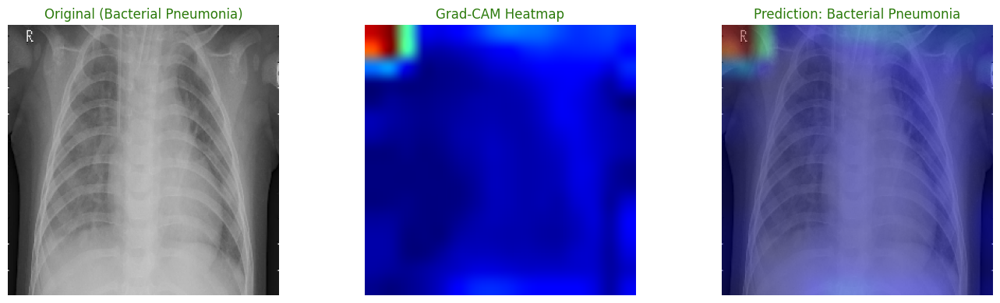

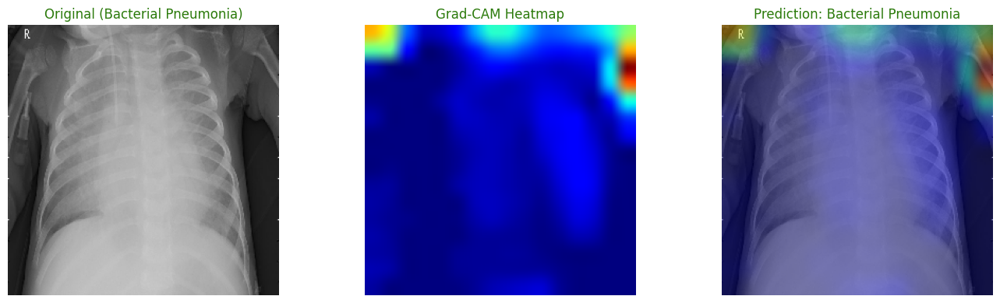

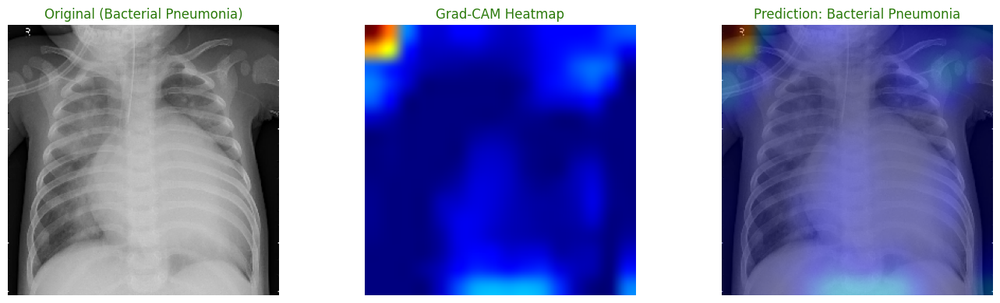

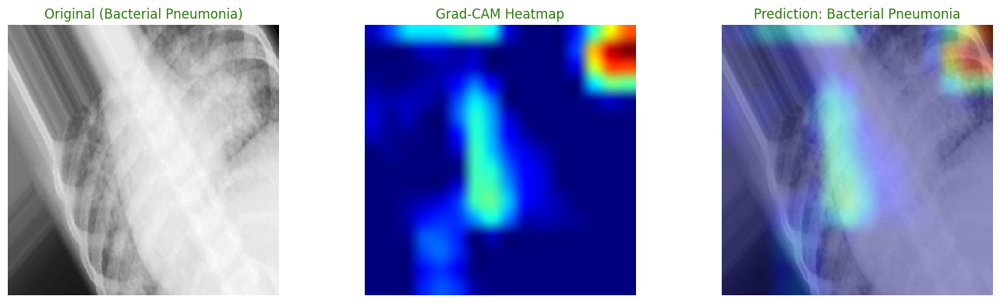

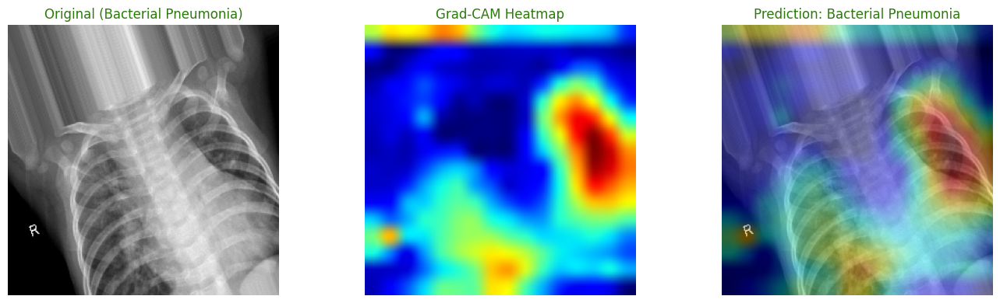

...

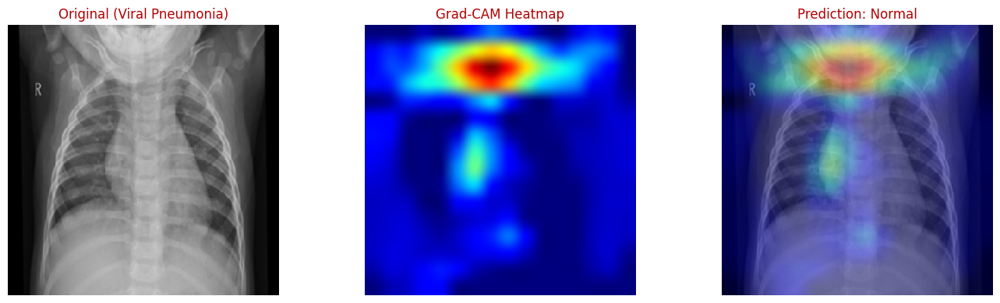

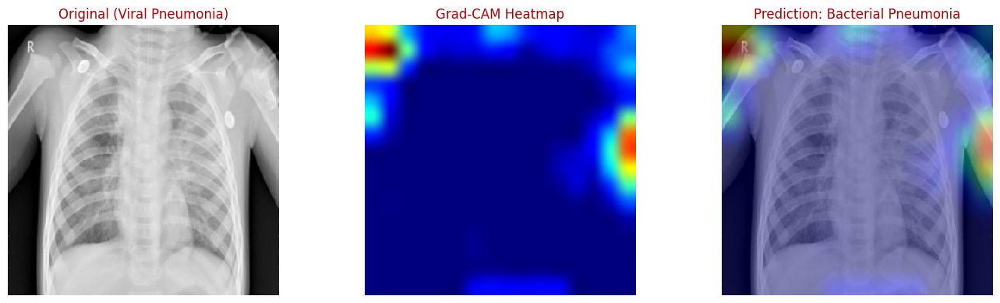

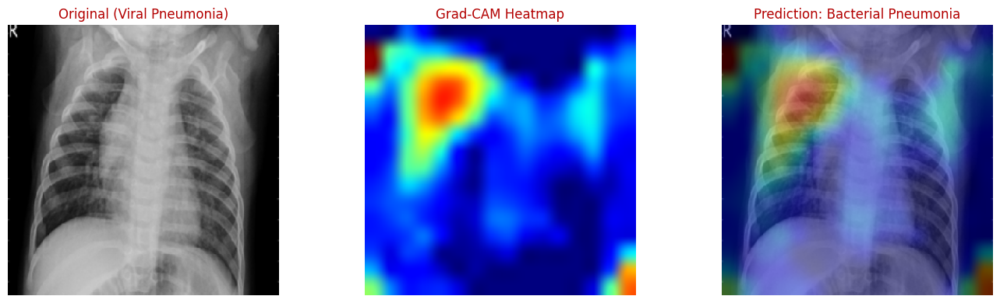

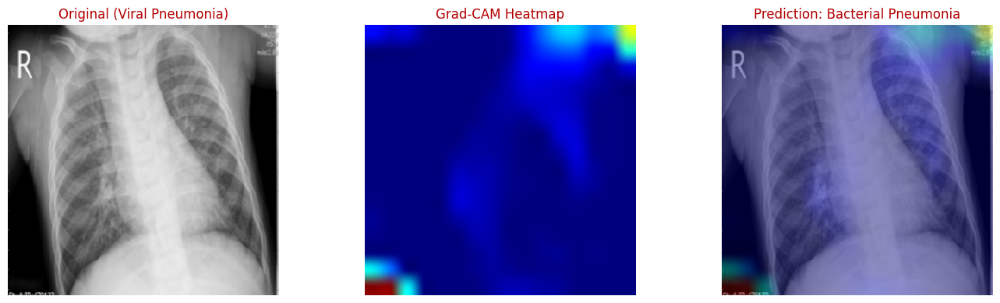

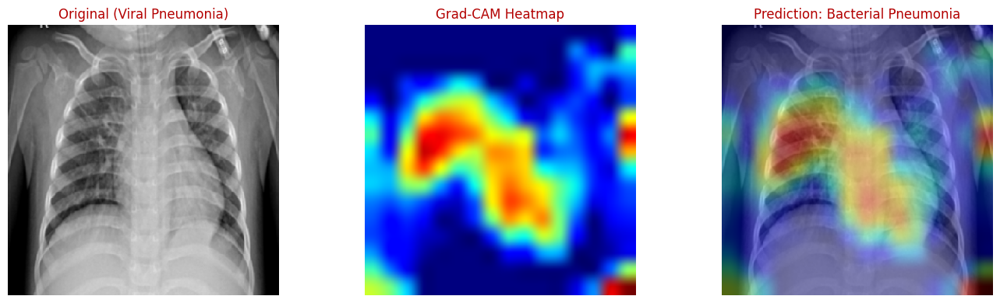

In [71]:
# ============================================================
# NEW CELL: Grad-CAM Visualization (Skip Bacterial Pneumonia)
# ============================================================

BACTERIAL_CLASS_INDEX = 1   # <<< Change if needed

# Select Grad-CAM layer based on best CNN
if best_cnn_model_name == 'VGG16':
    layer_name = 'block5_conv3'
elif best_cnn_model_name == 'ResNet50':
    layer_name = 'conv5_block3_3_conv'
elif best_cnn_model_name == 'InceptionV3':
    layer_name = 'mixed10'
else:
    raise Exception('Unknown CNN model')


# Unique classes in test labels
unique_classes = np.unique(test_labels_xgb)

for cls in unique_classes:

    # ====== SKIP BACTERIAL PNEUMONIA ======
    if int(cls) == BACTERIAL_CLASS_INDEX:
        print(f"Skipping Bacterial Pneumonia class index: {cls}")
        continue

    class_name = class_names[int(cls)]

    print("\n-----------------------------------")
    print(f"CLASS: {class_name}  (showing 5 Grad-CAM samples)")
    print("-----------------------------------")

    # Pick all indices where test labels match cls
    class_indices = np.where(test_labels_xgb == cls)[0]

    if len(class_indices) == 0:
        print("No samples found for this class.\n")
        continue

    # Pick 5 random samples
    sample_indices = np.random.choice(class_indices, size=min(5, len(class_indices)), replace=False)

    for idx in sample_indices:

        image = test_images[idx]
        actual_class = class_names[int(cls)]

        # ====== Grad-CAM ======
        heatmap = grad_cam(best_cnn_model, image, layer_name)

        # Normal class → NO HEATMAP COLOR
        if class_name.lower() == "normal":
            heatmap = np.zeros_like(heatmap)

        # Clip heatmap
        heatmap = np.maximum(heatmap, 0)
        heatmap = np.minimum(heatmap, 1)

        # Color map
        heatmap_colored = cm.jet(heatmap)[:, :, :3]
        heatmap_colored = np.uint8(255 * heatmap_colored)

        heatmap_resized = np.array(
            Image.fromarray(heatmap_colored).resize((image.shape[1], image.shape[0]))
        )

        # Fix original image
        img_uint8 = (image * 255).astype('uint8') if image.max() <= 1 else image.astype('uint8')

        # Superimpose
        superimposed = heatmap_resized * 0.4 + img_uint8 * 0.6
        superimposed = np.clip(superimposed, 0, 255).astype('uint8')

        # ====== HYBRID PREDICTION ======
        cnn_feature = best_cnn_model.predict(np.expand_dims(image, axis=0))
        required = final_hybrid_model.n_features_in_

        if cnn_feature.shape[1] > required:
            cnn_feature = cnn_feature[:, :required]
        elif cnn_feature.shape[1] < required:
            pad = required - cnn_feature.shape[1]
            cnn_feature = np.pad(cnn_feature, ((0, 0), (0, pad)), mode='constant')

        pred = final_hybrid_model.predict(cnn_feature)[0]
        pred_class = class_names[int(pred)]

        # Color titles
        title_color = "#2b7a0b" if pred_class == actual_class else "#b30000"

        # ====== PLOT ======
        plt.figure(figsize=(14, 4))

        plt.subplot(1, 3, 1)
        plt.imshow(img_uint8)
        plt.title(f"Original ({actual_class})", color=title_color)
        plt.axis("off")

        plt.subplot(1, 3, 2)
        plt.imshow(heatmap_resized)
        plt.title("Grad-CAM Heatmap", color=title_color)
        plt.axis("off")

        plt.subplot(1, 3, 3)
        plt.imshow(superimposed)
        plt.title(f"Prediction: {pred_class}", color=title_color)
        plt.axis("off")

        plt.tight_layout()
        plt.show()


## Chest X-Ray Image Verification

In [92]:
!pip install gdown


[notice] A new release of pip is available: 25.2 -> 25.3
[notice] To update, run: python.exe -m pip install --upgrade pip


In [94]:
!gdown --version

In [ ]:
# ================================================================
#  CHEST X-RAY DATASET DOWNLOAD + EXTRACTION + DATA GENERATORS
#  WINDOWS COMPATIBLE - EMOJI FREE VERSION
# ================================================================

import os
import zipfile
import sys
from keras.preprocessing.image import ImageDataGenerator

# -----------------------------
# 1. CONFIGURATION
# -----------------------------
dataset_name = "Chest-X-Ray-Verifier-Dataset"
download_link = "https://drive.google.com/uc?id=1J38IfhQYRgxQNuVDuHSegSD1MwjkK7MK"
zip_file_path = f"{dataset_name}.zip"

train_dir = f"{dataset_name}/Training"
val_dir = f"{dataset_name}/Validation"
test_dir = f"{dataset_name}/Testing"

batch_size = 32


# -----------------------------
# 2. DOWNLOAD DATASET (GDOWN)
# -----------------------------
print("Downloading dataset...")
os.system(f"gdown --fuzzy '{download_link}' -O {zip_file_path}")


# -----------------------------
# 3. EXTRACT ZIP (WINDOWS SAFE)
# -----------------------------
print("Extracting dataset...")

if os.path.exists(zip_file_path):
    with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
        zip_ref.extractall(".")
else:
    raise FileNotFoundError("Zip file not found! Download failed.")


# -----------------------------
# 4. VERIFY FOLDERS
# -----------------------------
print("Checking extracted directories...")

if not os.path.exists(train_dir):
    print("Training folder NOT FOUND:", train_dir)
    print("Root folder contains:", os.listdir("."))
    raise FileNotFoundError("Training directory missing!")

if not os.path.exists(val_dir):
    raise FileNotFoundError("Validation directory missing!")

if not os.path.exists(test_dir):
    raise FileNotFoundError("Testing directory missing!")

print("Dataset folders verified successfully.")


# -----------------------------
# 5. REQUIRE preprocess_image()
# -----------------------------
try:
    preprocess_image
except NameError:
    raise Exception("You must define preprocess_image() before running this code.")


# -----------------------------
# 6. DATA AUGMENTATION + GENERATORS
# -----------------------------
print("Preparing ImageDataGenerators...")

data_generator = ImageDataGenerator(
    preprocessing_function=preprocess_image,
    rotation_range=10,
    width_shift_range=0.05,
    height_shift_range=0.05,
    horizontal_flip=True,
    brightness_range=[0.8, 1.2],
    zoom_range=[0.8, 1.2]
)

val_datagen = ImageDataGenerator(preprocessing_function=preprocess_image)
test_datagen = ImageDataGenerator(preprocessing_function=preprocess_image)


# Temporarily suppress TensorFlow spam output
original_stdout = sys.stdout
sys.stdout = open(os.devnull, "w")

train_generator = data_generator.flow_from_directory(
    train_dir,
    target_size=(256, 256),
    batch_size=batch_size,
    class_mode='binary'
)

val_generator = val_datagen.flow_from_directory(
    val_dir,
    target_size=(256, 256),
    batch_size=batch_size,
    class_mode='binary'
)

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=(256, 256),
    batch_size=batch_size,
    class_mode='binary',
    shuffle=False
)

# Restore output
sys.stdout = original_stdout

print("Image generators created successfully.")
print("Classes detected:", train_generator.class_indices)
print("Training images:", train_generator.samples)
print("Validation images:", val_generator.samples)
print("Testing images:", test_generator.samples)


In [ ]:
''' Cell 23: Compile, Train, and Evaluate Chest X-Ray Image Verifier Model '''

# Import necessary library
from keras import layers

# Temporarily redirect standard output to null to suppress verbose output
original_stdout = sys.stdout
sys.stdout = open(os.devnull, 'w')

# Load VGG16 with pre-trained weights from ImageNet without top fully-connected layers
vgg16 = VGG16(weights='imagenet', include_top=False, input_shape=(256, 256, 3))

# Restore standard output to original state
sys.stdout = original_stdout

# Freeze layers of base CNN model
for layer in vgg16.layers:
    layer.trainable = False

# Create new CNN model
x = layers.Flatten()(vgg16.output)
x = layers.Dense(512, activation='relu')(x)
x = layers.Dropout(0.5)(x)
predictions = layers.Dense(1, activation='sigmoid')(x)
verifier_model = Model(inputs=vgg16.input, outputs=predictions)

# Compile CNN model
verifier_model.compile(optimizer=Adam(learning_rate=0.0001), loss='binary_crossentropy', metrics=['accuracy'])

# Fit CNN model to data
verifier_model.fit(
    train_generator,
    steps_per_epoch=train_generator.samples // train_generator.batch_size,
    epochs=10,
    validation_data=val_generator,
    validation_steps=val_generator.samples // val_generator.batch_size,
    verbose=0
)

# Display accuracy of chest X-ray image verifier model
loss, accuracy = verifier_model.evaluate(test_generator)
print('\n\033[1m\033[36m' + f'Accuracy of VGG16 Chest X-Ray Image Verifier Model on Testing Set: {accuracy * 100:.2f}%' + '\033[0m\n')

In [ ]:
print('\n\033[1m\033[36m' + f'Accuracy of VGG16 Chest X-Ray Image Verifier Model on Testing Set: {accuracy * 100:.2f}%' + '\033[0m\n')

In [97]:
''' Cell 24: Save and Download Chest X-Ray Image Verifier Model '''

# Save chest X-ray image verifier model in H5 format
verifier_model.save('VGG16-Chest-X-Ray-Verifier-Model.h5')

print("Model saved successfully as VGG16-Chest-X-Ray-Verifier-Model.h5")